# Connect to Google Drive 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import os
import numpy as np
import torch
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import operator
import io
import time
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data.sampler import SubsetRandomSampler
import pandas as pd
import scipy.signal as sg
from pathlib import Path
import cv2
from google.colab.patches import cv2_imshow

# Data Processing: Character Segmentation

In [ ]:
class ImageFolderWithFileName(datasets.ImageFolder):
    """Custom dataset that includes image file paths. Extends
    torchvision.datasets.ImageFolder
    """

    # override the __getitem__ method. this is the method that dataloader calls
    def __getitem__(self, index):
        # this is what ImageFolder normally returns 
        original_tuple = super(ImageFolderWithFileName, self).__getitem__(index)
        # the image file path
        path = Path(self.imgs[index][0]).name
        if path.endswith("jpg") or path.endswith("png"):
          if "_" not in path:
            path = path.split(".")[0]
        #print('kan', type(original_tuple))
        ret_with_name = (original_tuple[:1] + (path,))
        return ret_with_name

data_dir = "/content/drive/My Drive/APS360 Project/Final Submissions/Lisense Plate Images/"
dataset = ImageFolderWithFileName(data_dir) # our custom dataset

# print(dataset[0][0], dataset[0][1])
dataloader = torch.utils.data.DataLoader(dataset, batch_size=5)

In [ ]:
def separate_list(my_list, threshold, block=1, output=False):
    result = []
    result_index = []
    section = []
    section_index = []
    step_count = 0
    for i in range(len(my_list)):
        if my_list[i] < threshold:
            step_count += 1
            if section != [] and step_count >= block:
                if output: print(section[0], section[-1])
                result.append(section)
                result_index.append(section_index)
                section = [] # start new list
                section_index = []
                step_count = 0
        else: 
          section_index.append(i)
          section.append(my_list[i])
    if section != []: # Handle last group
        if output: print(section[0], section[-1])
        result.append(section)
        result_index.append(section_index)
    return result, result_index

In [ ]:
!pip install scikit-image

In [ ]:
from PIL import Image
from google.colab import files 
from skimage.filters import threshold_otsu, threshold_local

def segment_chars(data_dir, train_folder, path, save=False):
  train_dir = os.path.join(data_dir, train_folder)

  data_transform = transforms.Compose([transforms.ToTensor()])
  train_data = ImageFolderWithFileName(train_dir, transform=data_transform)

  trans = transforms.ToPILImage()

  # choose whether to display the results of the transformations
  output = False
  cropped_characters = []
  character_labels = []
  count = 0

  for img, label in iter(train_data): 
    
    # create a new plot
    plt.figure()

    # convert to PIL
    img_pil = trans(img)

    # convert PIL to grayscale
    img_gray = img_pil.convert('L')

    # display these transitions
    plt.title("Reg Image")
    plt.imshow(img_pil)
    plt.show()

    if output:      
      plt.title("Grayscale Image")
      plt.imshow(img_gray, cmap='gray')
      plt.show()
    
    max_white = np.array(img_gray).size
    current_sum = 0

    attempt = 1
    while (attempt < 3):

      # Make 2 attempts with different thresholding methods to get a reasonable result
      if attempt == 1:
        # Method 1 - hard global threshold
        # convert to binary
        threshold = 100
        fn = lambda x : 255 if x > threshold else 0
        img_bin = img_gray.point(fn, mode='1')  
        if output:
          plt.title("Binary Image")
          plt.imshow(img_bin, cmap='gray')
          plt.show()
      else:
        # Method 2 - otsu threshold
        image = np.array(img_gray)
        local_thresh = threshold_otsu(image)
        img_bin = image > local_thresh
        if output:
          plt.title("Binary Image")
          plt.imshow(img_bin, cmap='gray')
          plt.show()

      # Convert to a numpy array
      img_bin = np.array(img_bin)

      # if more than half of the image is white, invert it
      if np.sum(img_bin) > (img_bin.size / 2):
        # invert the image
        # 255 - original black, 0 - original white
        img_bin = np.invert(img_bin)

      im_bin_inv = (np.array(img_bin)) * 255

      # horizontal histogram plot
      img_row_sum = np.sum(im_bin_inv,axis=1).tolist()
      min_sum = np.min(img_row_sum)
      avg_sum = np.mean(img_row_sum)
      if output: print("AVG horiz:", min_sum + 0.3 * avg_sum)
      
      y_vals = np.arange(len(img_row_sum))
      if output:
        plt.plot(img_row_sum, y_vals)
        plt.show()

      # separate into chunks at points where histogram goes below threshold
      # get indexes and values of each chunk
      new_vals, new_ranges = separate_list(img_row_sum, min_sum + 0.30*avg_sum)
    
      horizontal_sec = []
      for i in range(len(new_vals)):
        indexes = new_ranges[i]
        # only take the largest section
        if len(indexes) > len(horizontal_sec):
          horizontal_sec = indexes

      if horizontal_sec == []:
        horizontal_sec = y_vals

      if output: print(horizontal_sec[0], horizontal_sec[-1])

      # crop the image, to work with only the relevant section
      horizontal_crop = im_bin_inv[horizontal_sec[0]:horizontal_sec[-1], :]
      if output:
        plt.imshow(horizontal_crop, cmap='gray')
        plt.show()

      # vertical histogram plot
      img_column_sum = np.sum(horizontal_crop,axis=0).tolist()
      if output:
        plt.plot(img_column_sum)
        plt.show()

      min_sum = np.min(img_column_sum)
      max_sum = np.max(img_column_sum)
      sum_range = max_sum - min_sum
      # separate into chunks at points where histogram goes below threshold
      new_vert_vals, new_vert = separate_list(img_column_sum, min_sum + 0.01*sum_range)

      avg_vert_sum = np.mean(img_column_sum)
      if output: print("avg_vert:", (7/8)*avg_vert_sum)

      lens = []
      for e in new_vert:
        lens.append(len(e))

      med = np.median(lens)
      med_min = med - 0.1*med
      med_max = med + 0.1*med
      if output: print("Average char width:", med, "range:", med_min, med_max)
      chars = []
      min_length = (1/4)*med
      for i in range(len(lens)):
        # if the range starts at the edge of the frame, probably isn't a character
        if (new_vert[i][0] == 0) or (new_vert[i][-1] == len(img_column_sum)-1):
          continue

        # Add characters that are within the margin of an avg char
        if lens[i] < med_max and lens[i] > med_min:
          chars.append(new_vert[i])
        elif lens[i] > min_length:     # check if char is a 1, since they aren't avg width
          if np.mean(new_vert_vals[i]) > (7/8)*avg_vert_sum:
            chars.append(new_vert[i])
          if output: print("range:", new_vert[i][0], new_vert[i][-1], "mean:", np.mean(new_vert_vals[i]))

      height = horizontal_crop.shape[0]
      for c in chars:
        bin_crop = horizontal_crop[:, c[0]:c[-1]]
        # horizontal histogram char plot
        char_sum = np.sum(np.array(bin_crop), axis=1).tolist()
        avg_char_sum = np.mean(char_sum)

        new_char_vals, new_char_ranges = separate_list(char_sum, 1, block=5)

        # If the height of a character is less than the 7/8 of the normal height
        # remove the "char" since license plate chars are standard height
        for e in new_char_ranges:
          # get the length between the first and last index
          length_e = e[-1] - e[0] + 1
          if length_e < (7/8)*height and length_e > 10:
            try:
              chars.remove(c)
            except:
              pass
            if output:
              plt.imshow(bin_crop, cmap='gray')
              plt.show()

              y_vals = np.arange(len(char_sum))
              plt.plot(char_sum, y_vals)
              plt.show()

      # If we don't have the right number of characters according to the label, try a different
      # thresholding method
      if len(chars) == len(label):
        attempt = 5
      else:
        attempt += 1

    cropped_chars = []
    char_labels = []
    k = 0
    # crop the original PIL image into characters
    for c in chars:
      area = [c[0], horizontal_sec[0], c[-1], horizontal_sec[-1]]
      crop = img_pil.crop(area)
      cropped_chars.append(crop)
      char_labels.append(label + "_" + str(k+1))
      k += 1

    x = label.split("_")
    #print(x)
    #print(len(x[0]))
    #print(len(char_labels))

    #remove images from set that does not have number of lisense plate 
    #characters that is expected
    
    print(len(cropped_chars))
    if len(char_labels) == len(x[0]):
      for i in range(len(cropped_chars)):
        cropped_characters.append(cropped_chars[i])
        character_labels.append(char_labels[i])

        #plotting only acceptable lisense plate characters
        plt.subplot(1, len(cropped_chars), i+1)
        plt.title(str(i+1))
        plt.axis('off')
        plt.tight_layout()
        plt.imshow(cropped_chars[i])
        
        # save the cropped characters to drive to use as input for model
        # will disregard this process
        if save: 
          print("Images saved in directory")
          cropped_chars[i].save(path + char_labels[i] + ".png", "PNG")
        else:
          print("Images not saved in directory")

    else:
      count += 1

  return cropped_characters, character_labels, count, len(train_data)


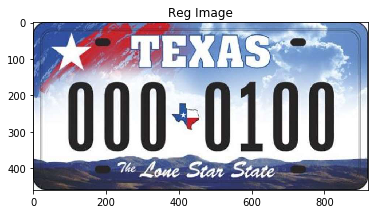

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


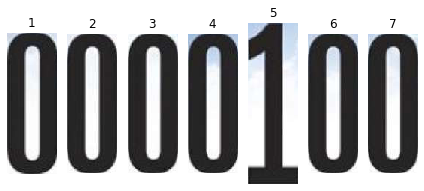

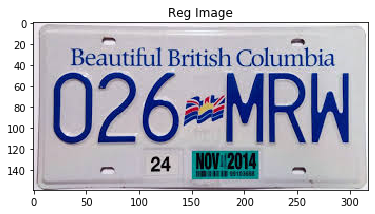

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


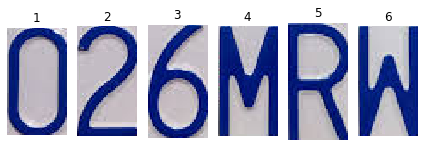

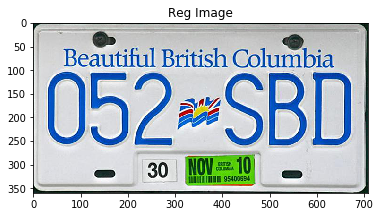

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


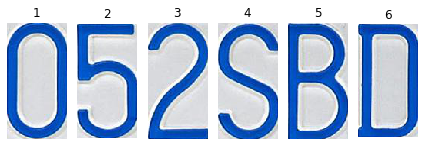

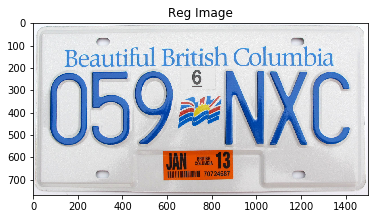

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


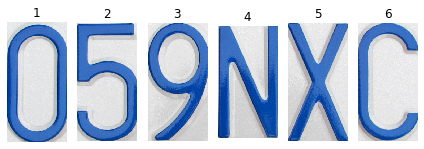

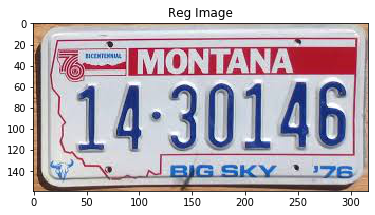

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


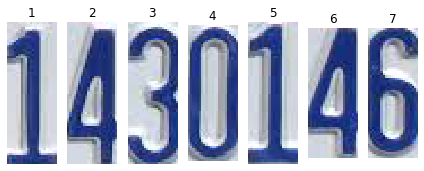

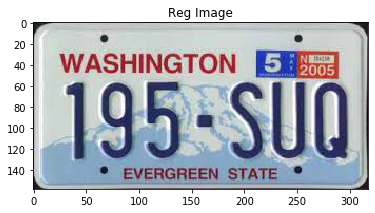

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


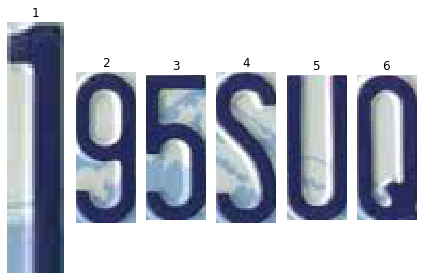

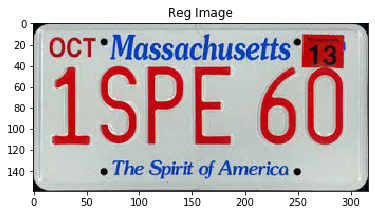

3


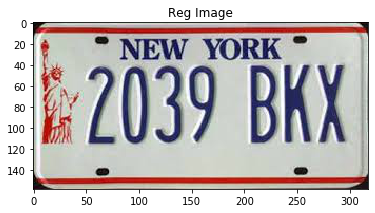

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


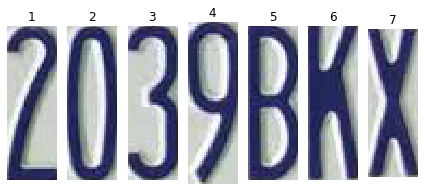

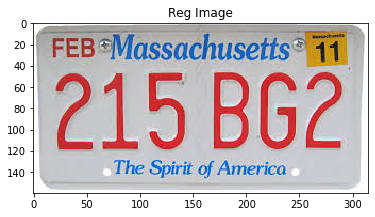

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


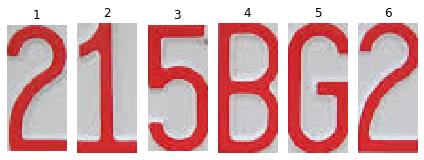

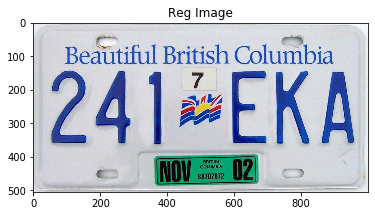

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


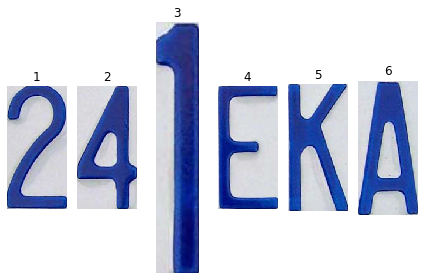

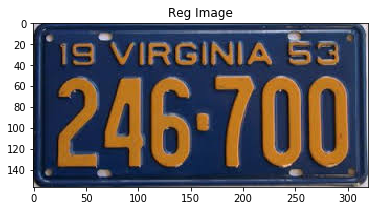

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


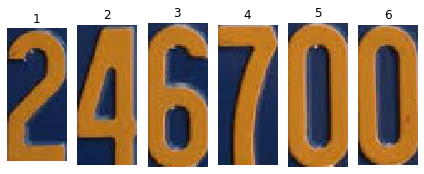

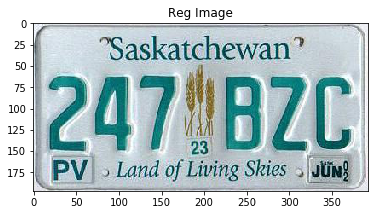

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


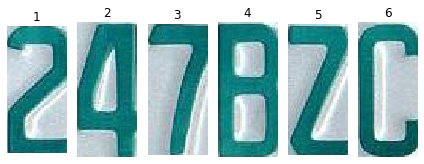

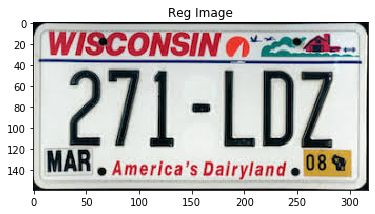

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


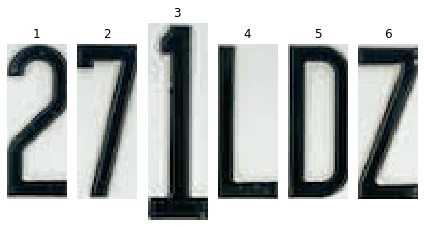

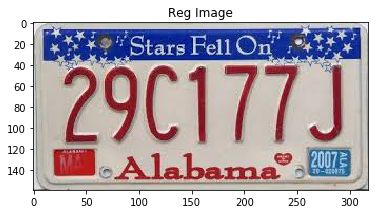

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


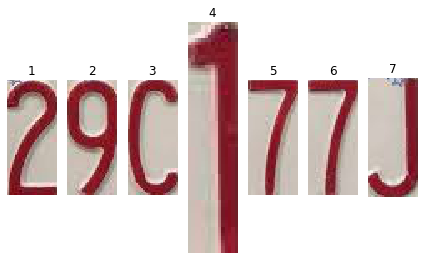

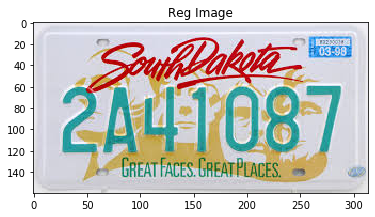

1


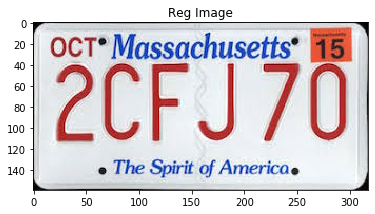

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


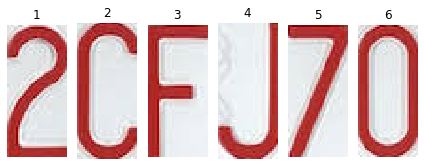

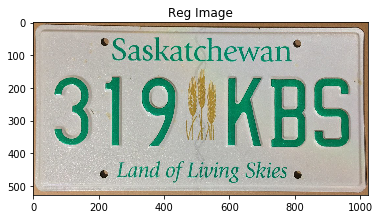

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


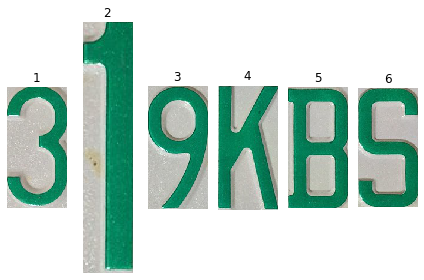

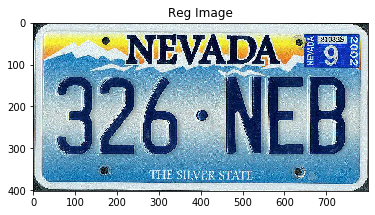

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


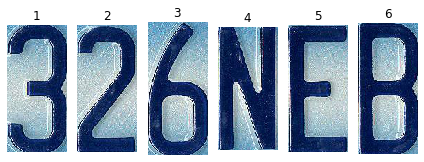

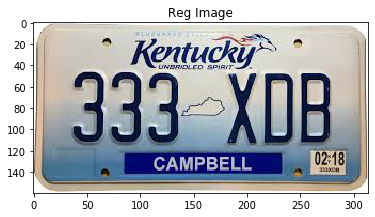

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


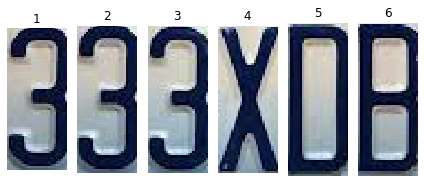

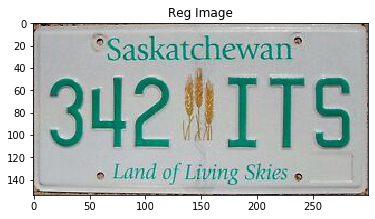

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


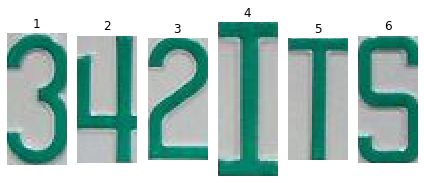

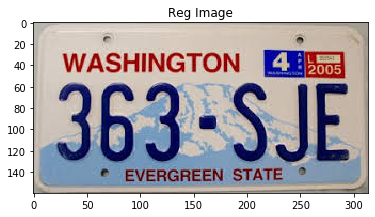

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


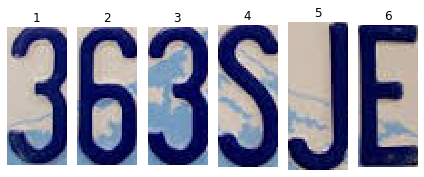

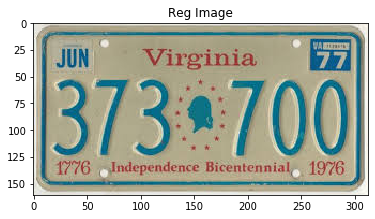

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


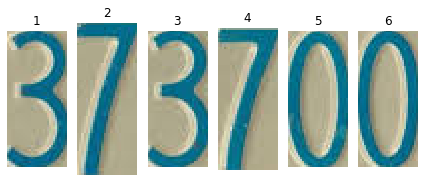

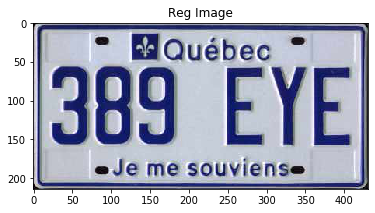

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


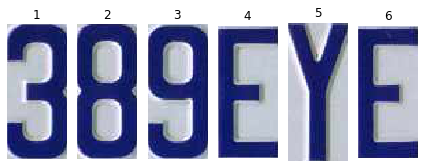

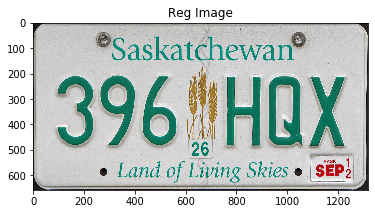

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


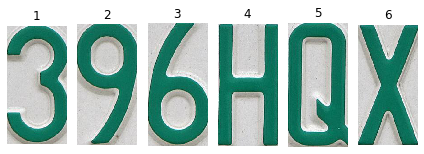

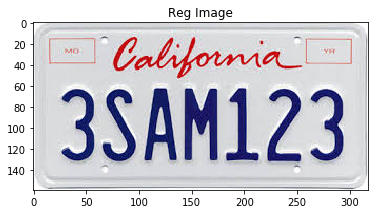

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


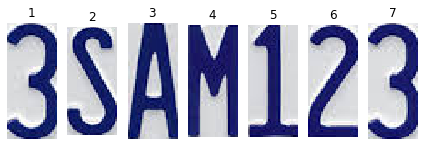

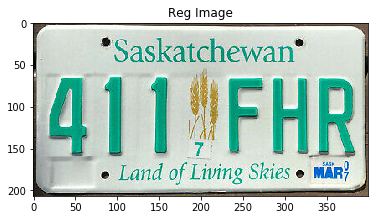

7


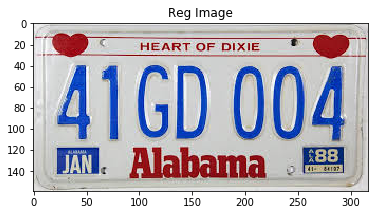

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


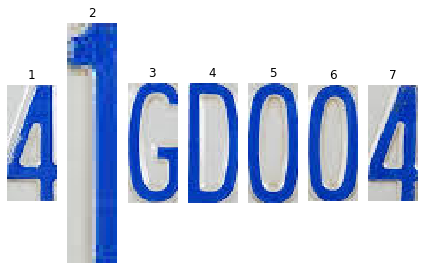

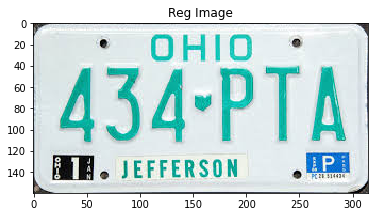

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


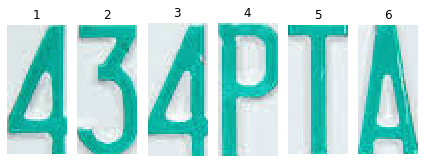

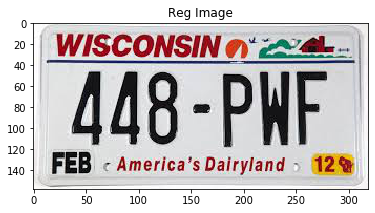

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


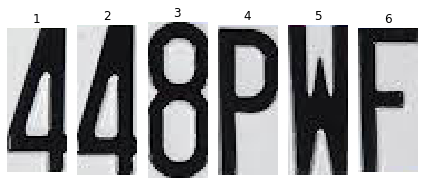

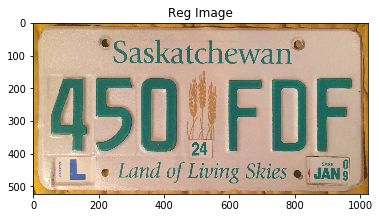

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


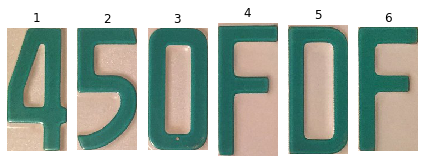

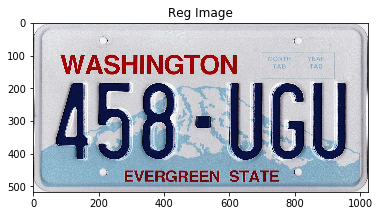

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


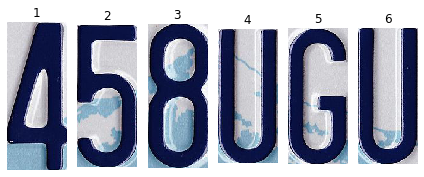

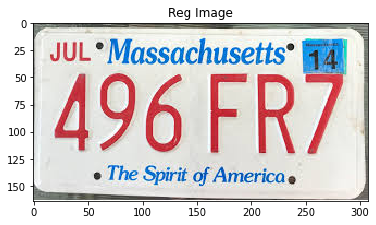

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


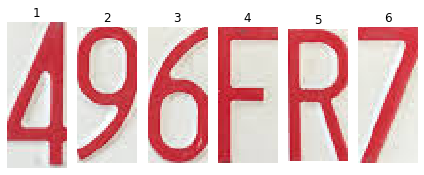

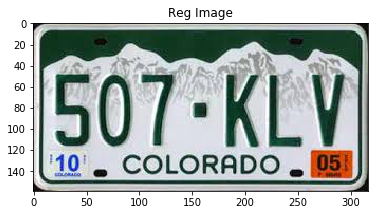

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


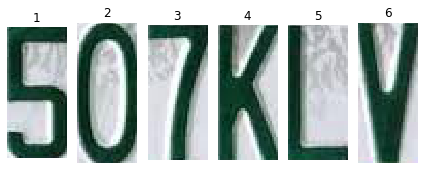

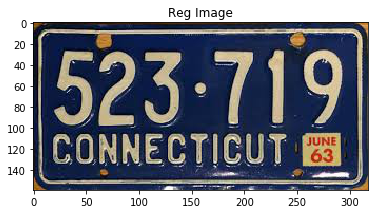

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


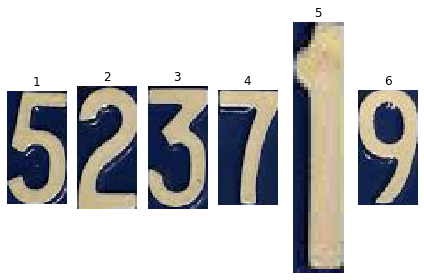

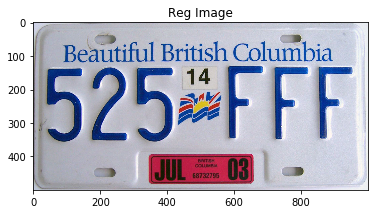

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


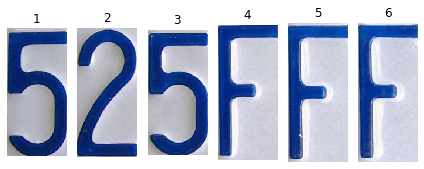

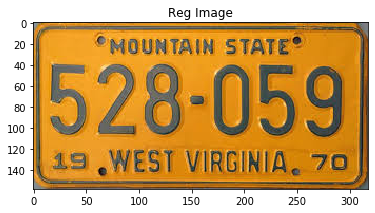

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


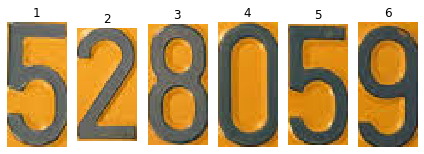

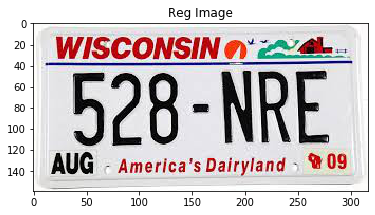

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


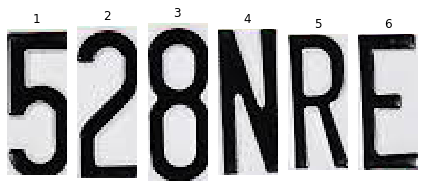

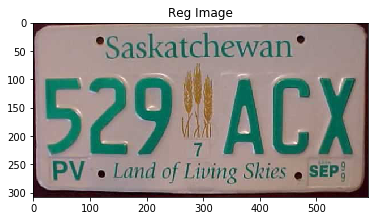

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


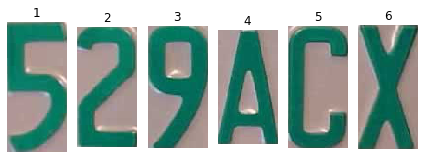

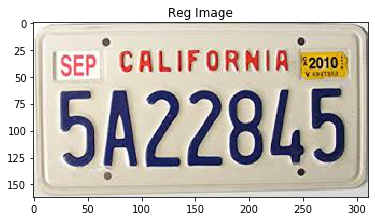

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


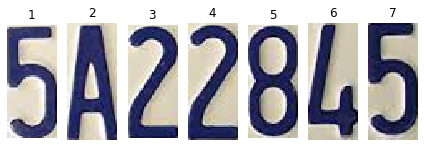

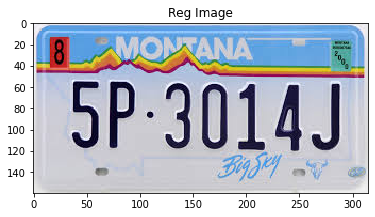

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


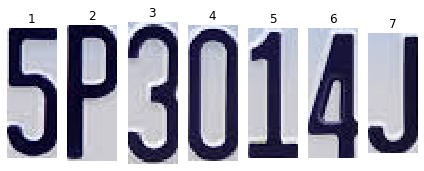

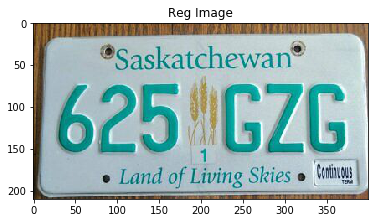

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


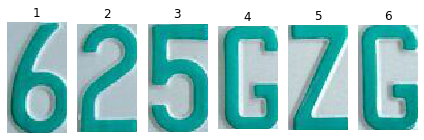

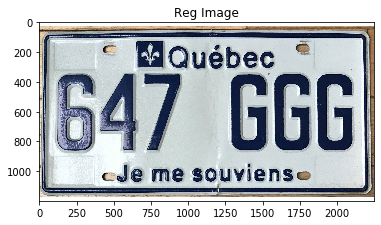

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


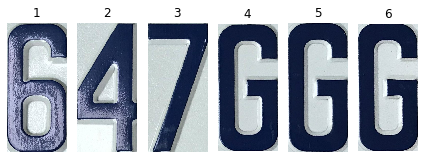

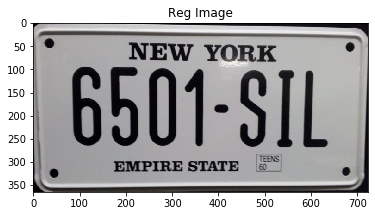

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


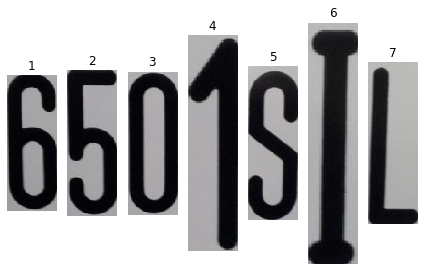

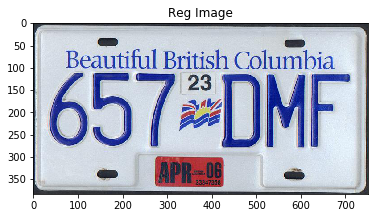

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


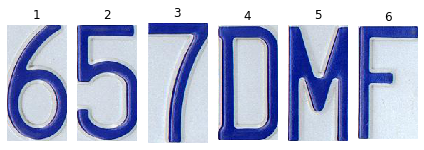

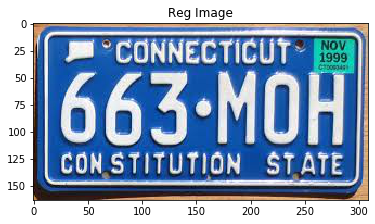

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


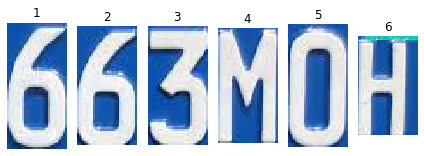

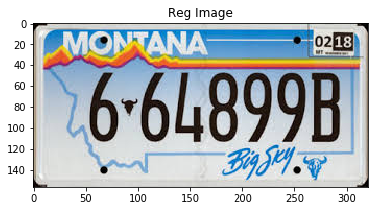

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


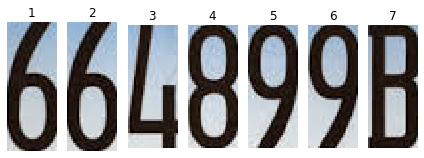

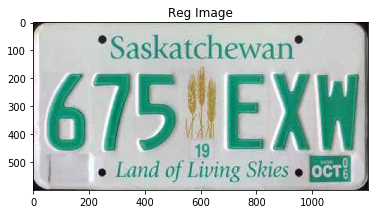

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


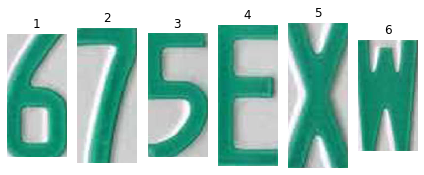

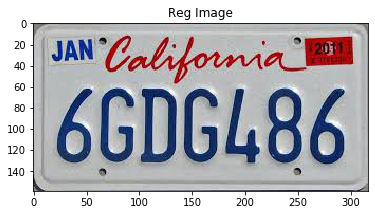

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


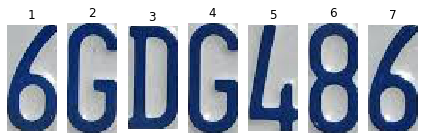

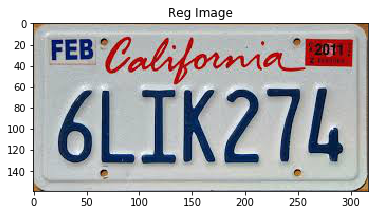

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


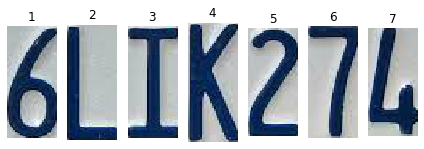

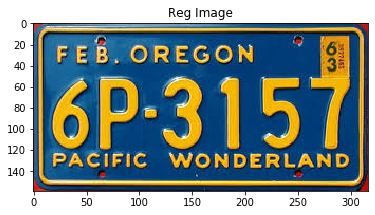

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


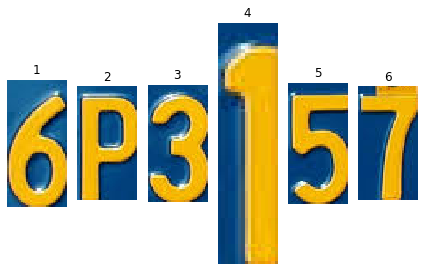

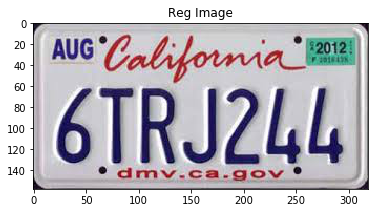

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


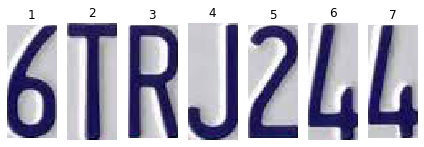

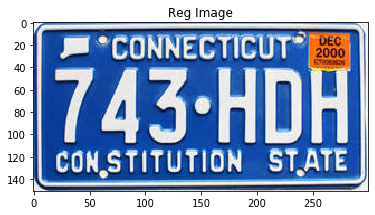

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


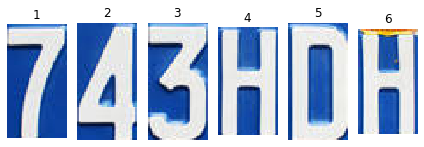

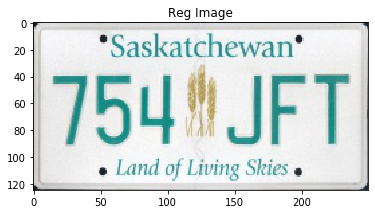

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


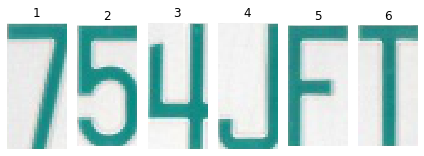

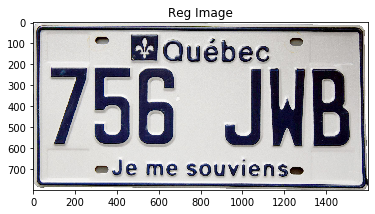

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


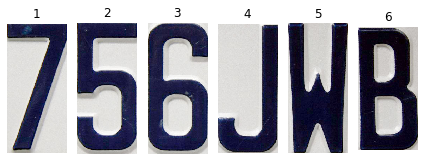

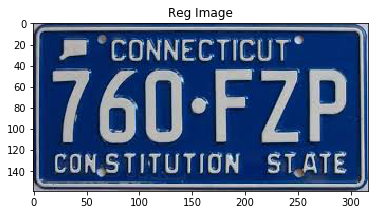

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


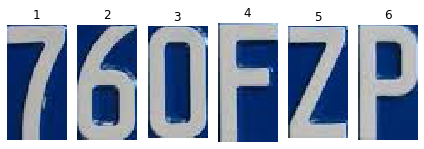

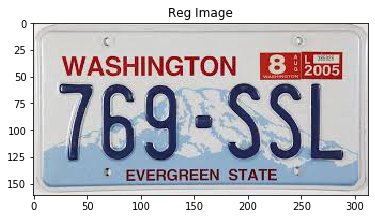

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


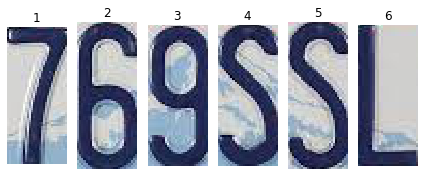

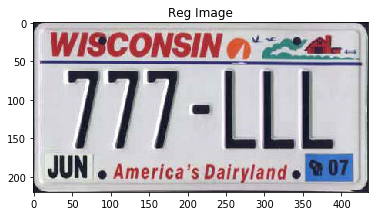

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


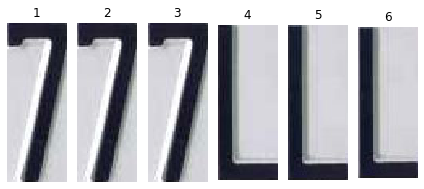

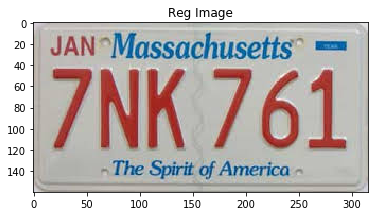

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


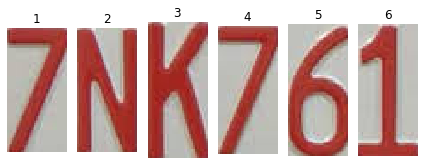

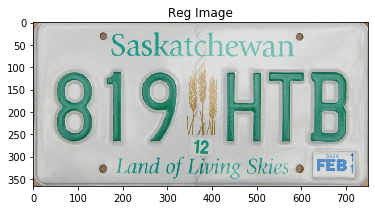

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


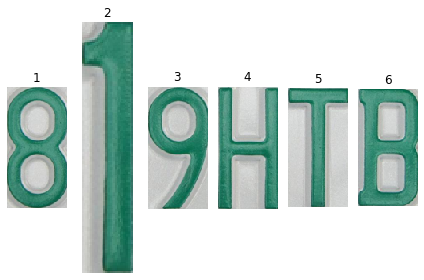

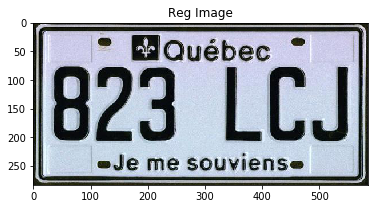

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


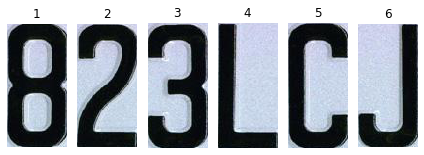

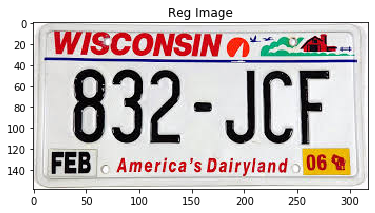

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


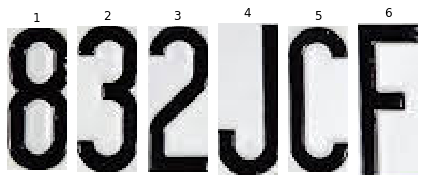

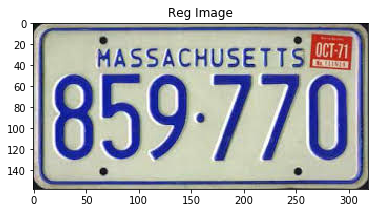

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


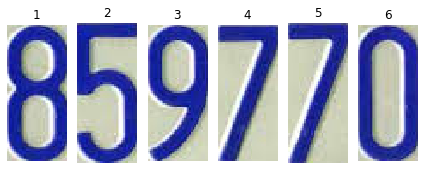

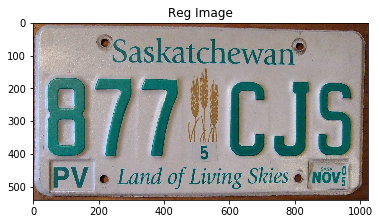

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


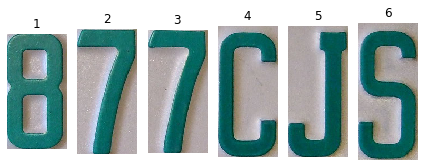

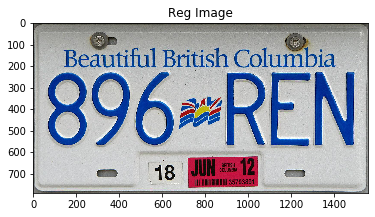

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


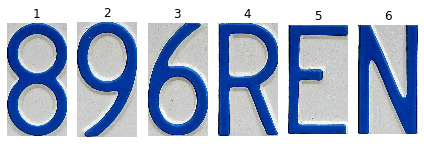

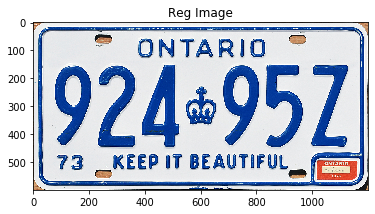

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


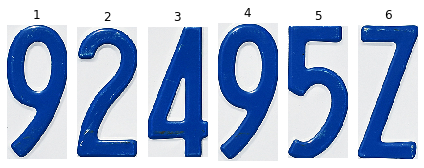

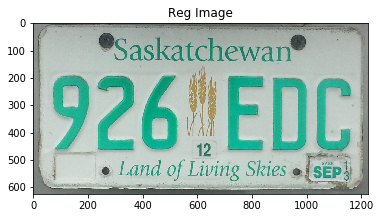

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


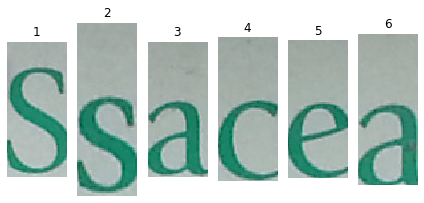

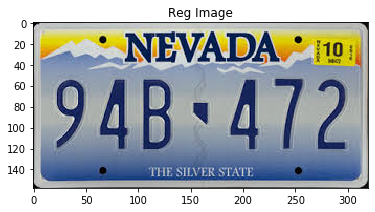

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


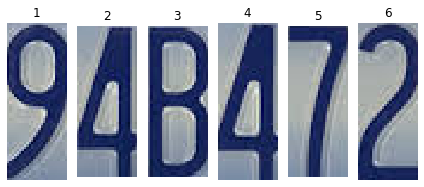

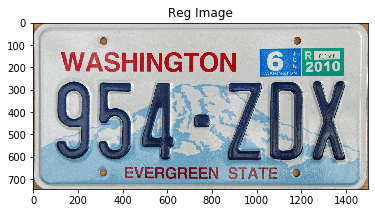

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


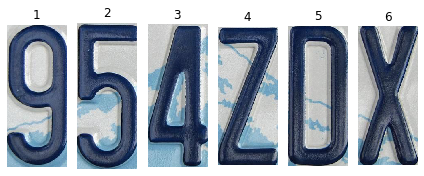

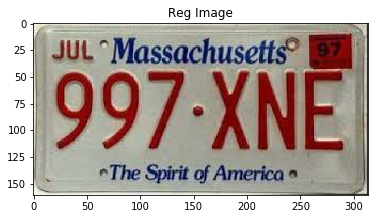

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


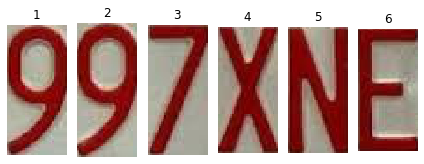

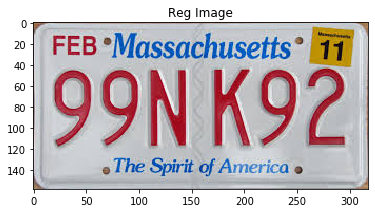

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


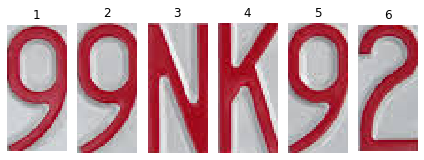

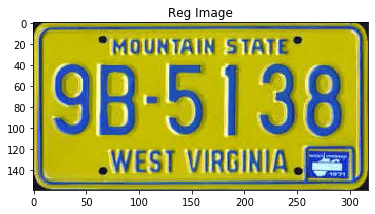

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


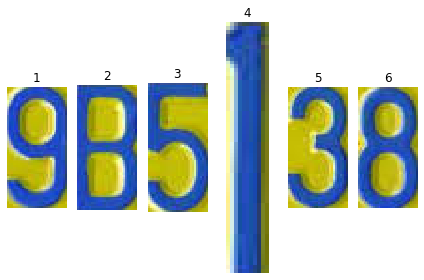

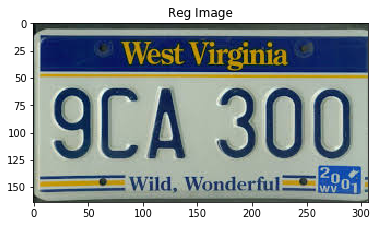

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


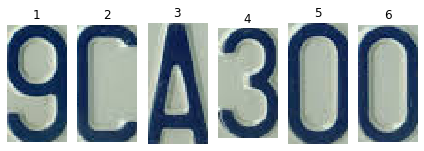

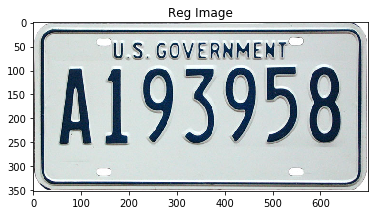

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


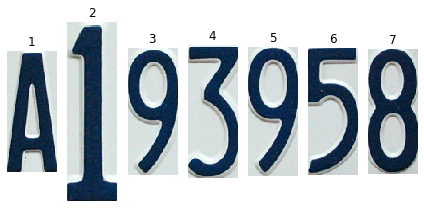

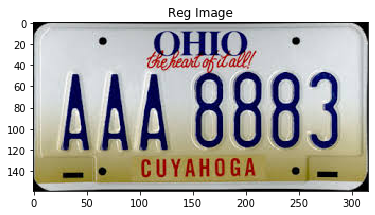

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


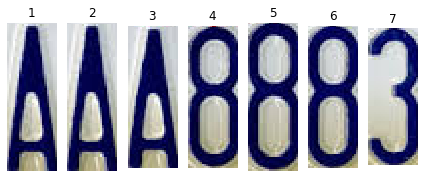

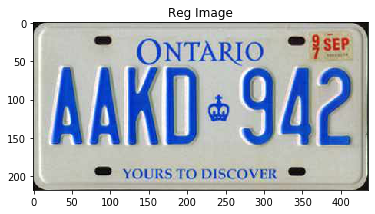

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


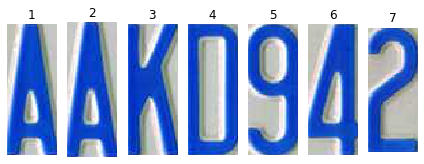

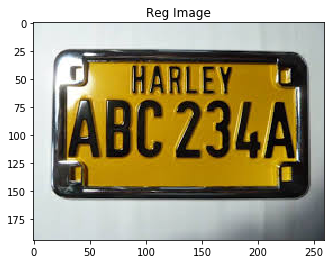

8


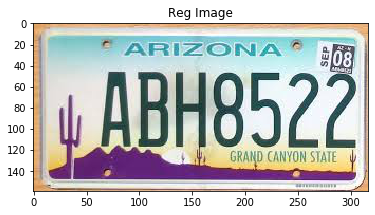

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


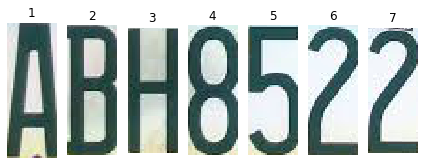

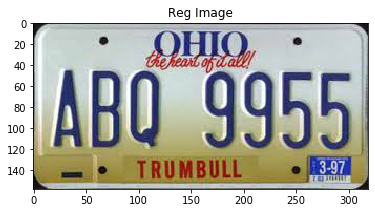

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


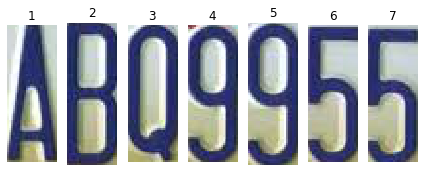

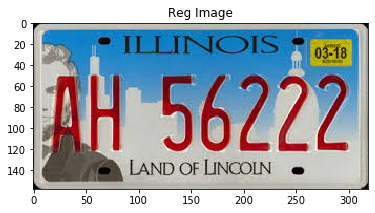

1


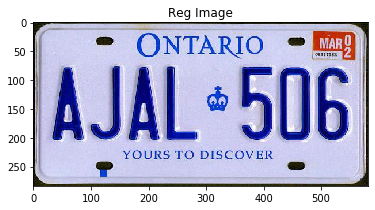

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


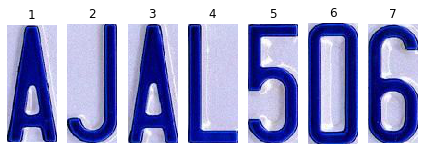

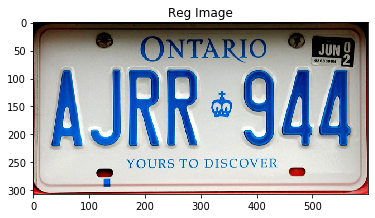

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


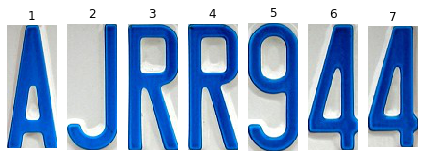

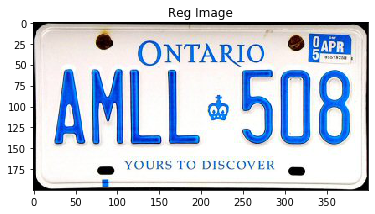

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


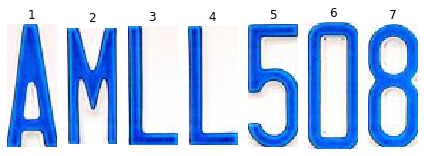

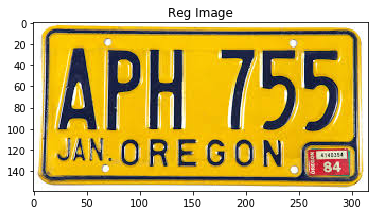

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


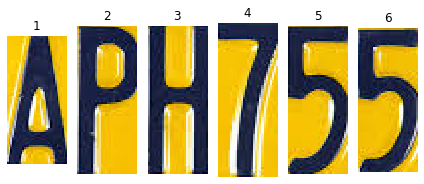

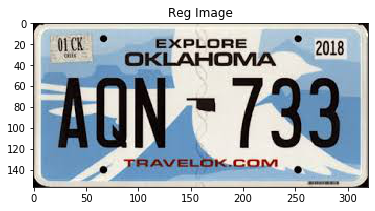

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


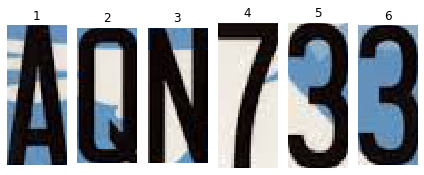

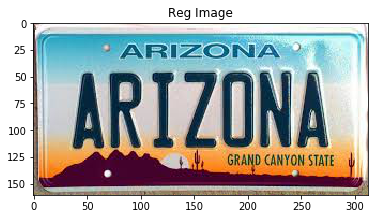

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


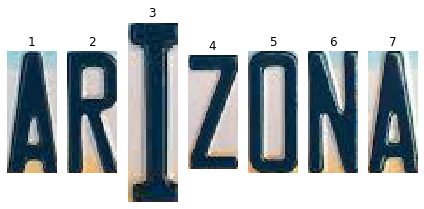

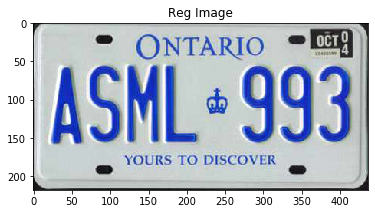

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


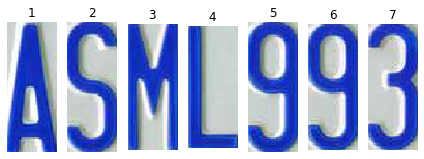

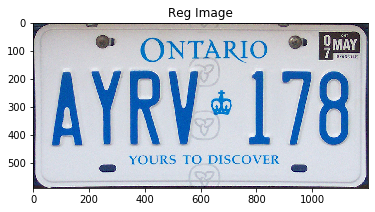

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


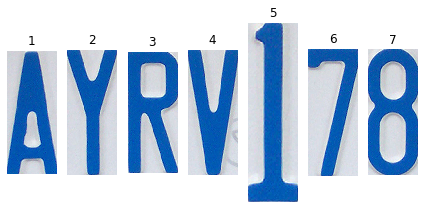

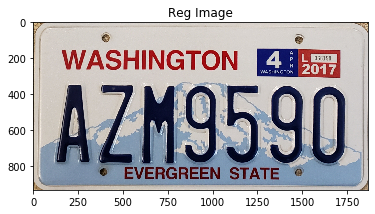

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


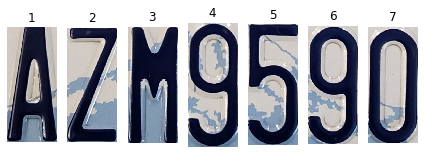

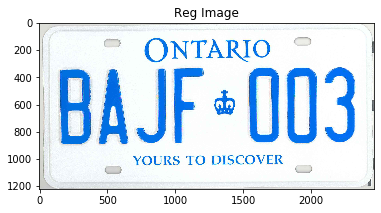

7


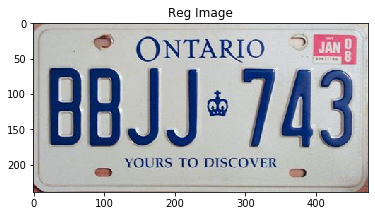

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


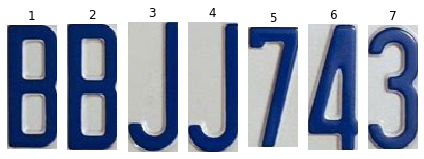

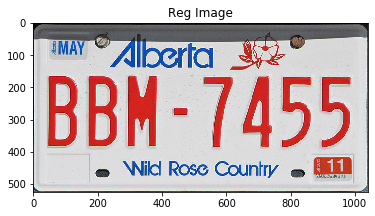

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


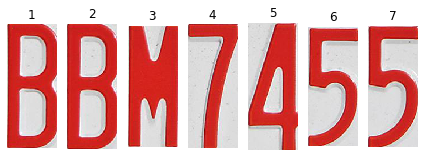

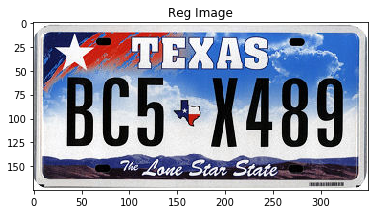

2


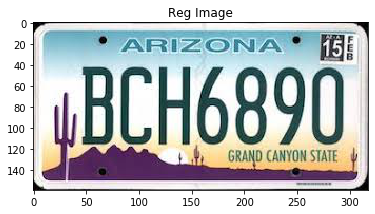

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


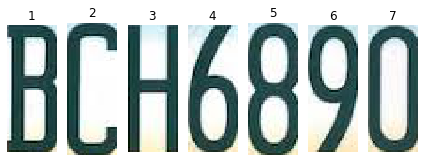

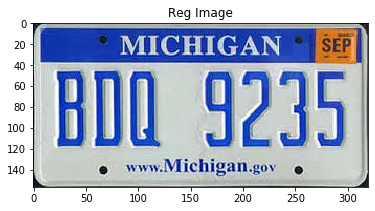

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


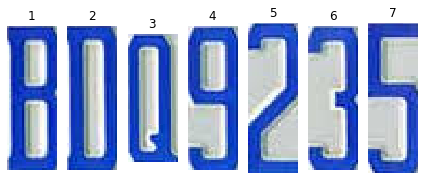

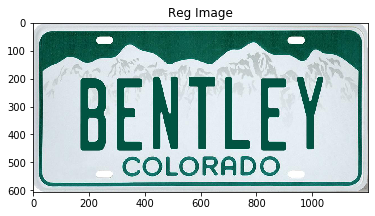

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


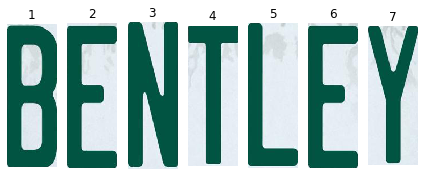

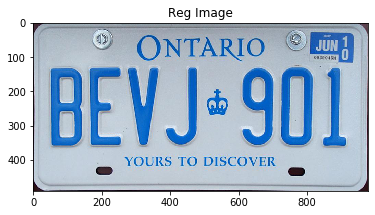

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


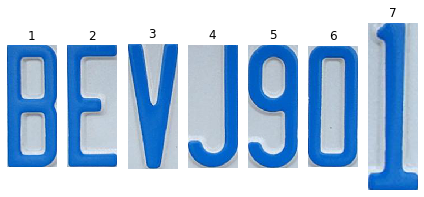

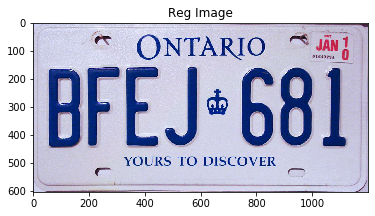

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


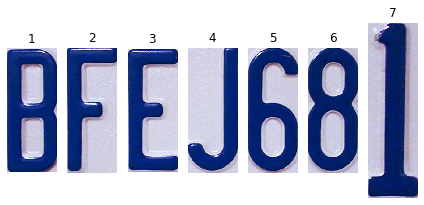

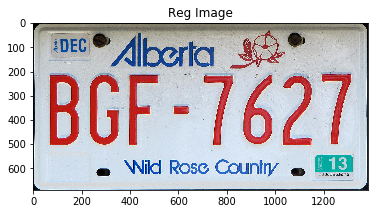

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


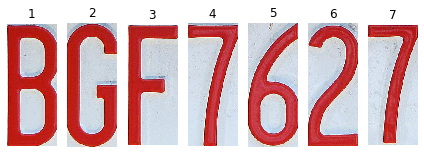

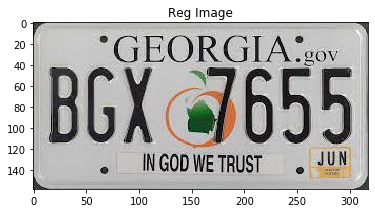

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


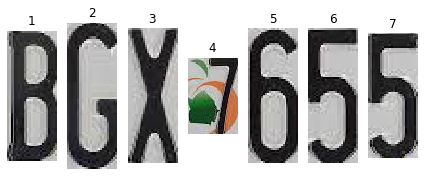

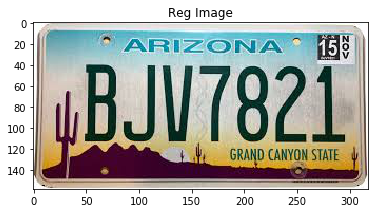

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


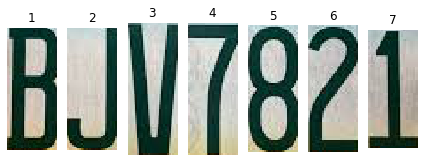

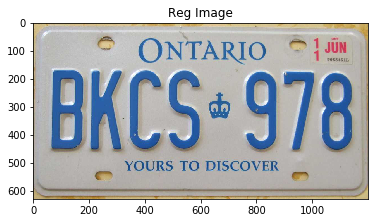

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


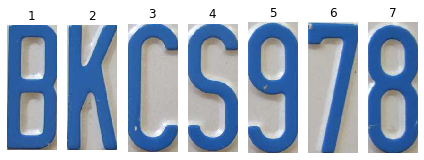

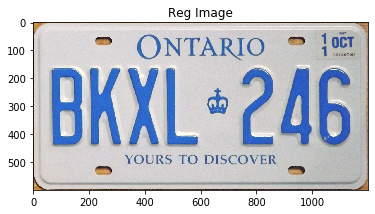

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


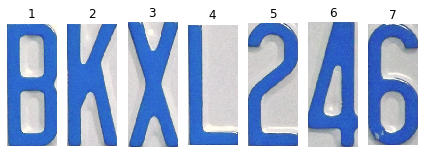

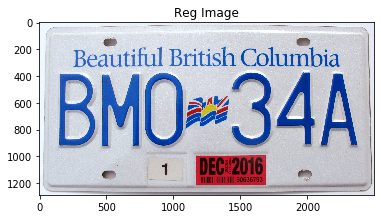

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


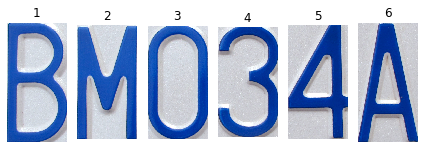

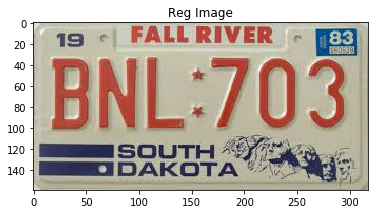

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


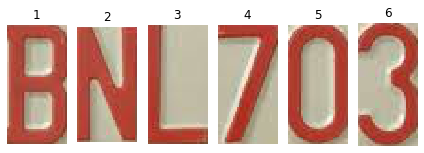

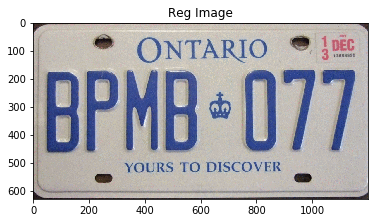

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


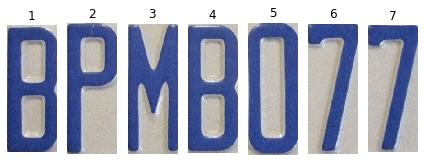

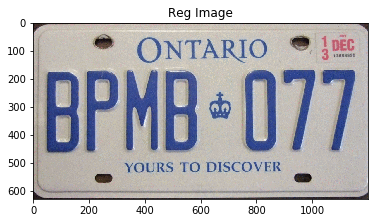

7


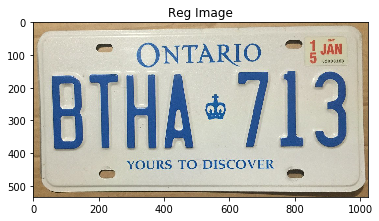

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


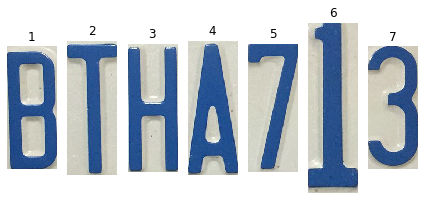

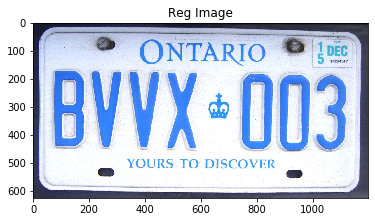

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


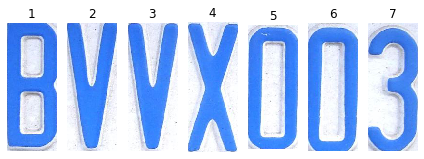

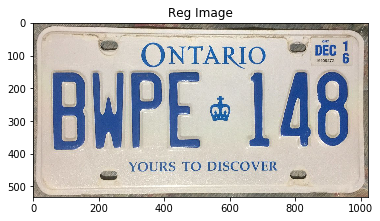

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


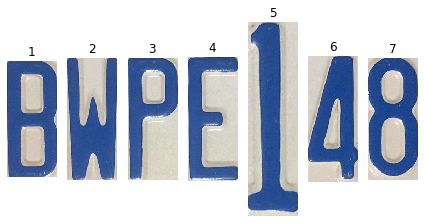

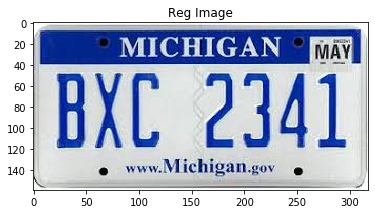

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


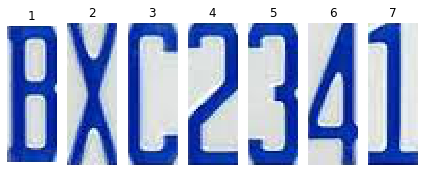

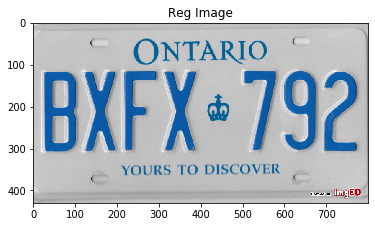

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


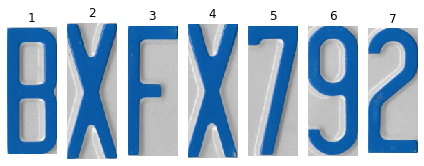

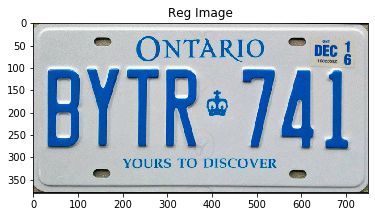

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


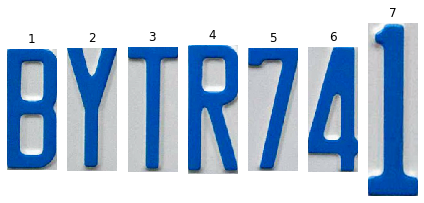

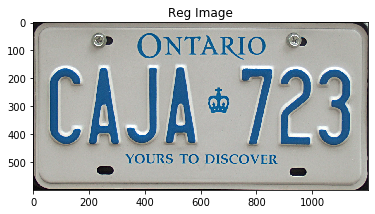

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


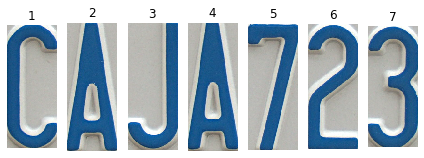

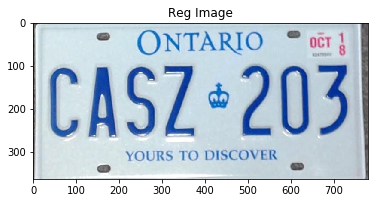

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


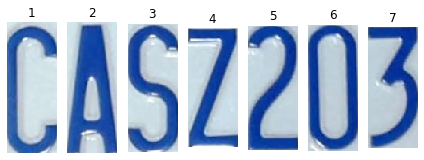

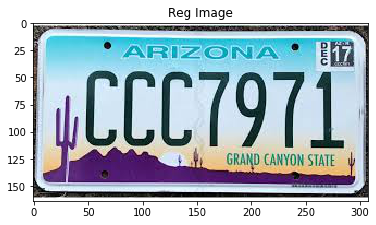

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


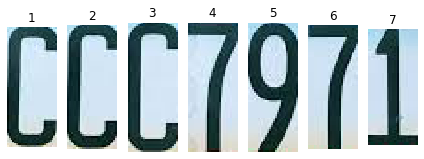

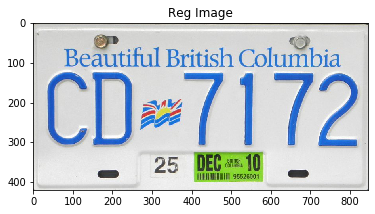

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


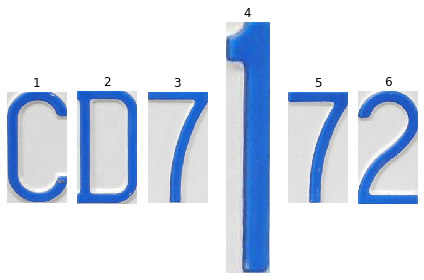

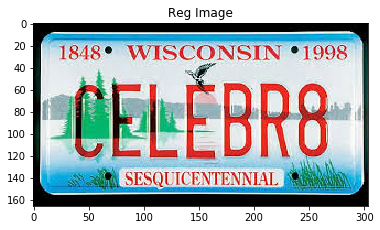

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


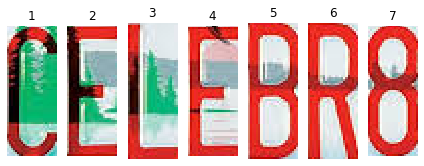

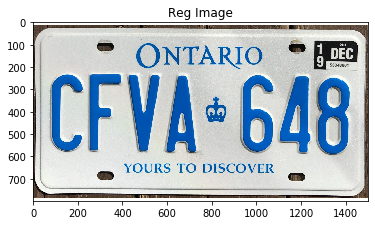

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


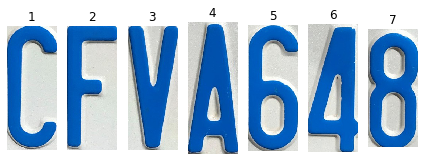

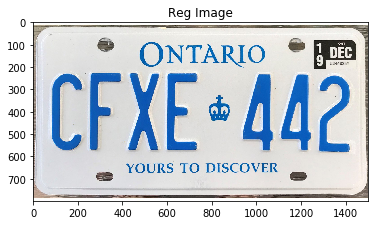

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


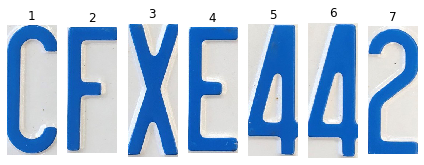

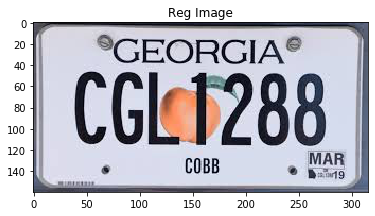

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


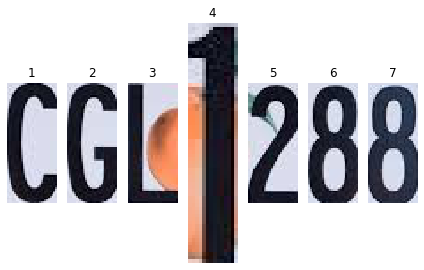

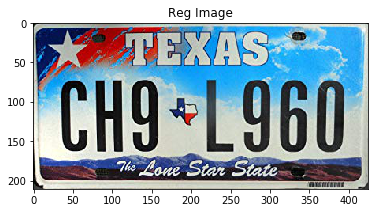

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


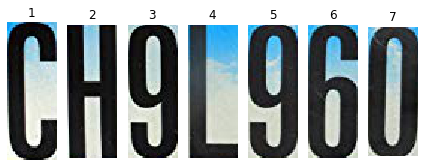

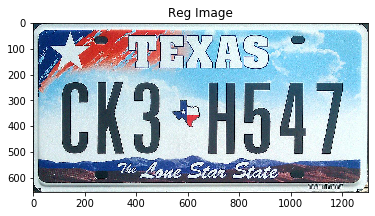

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


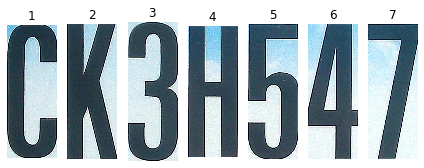

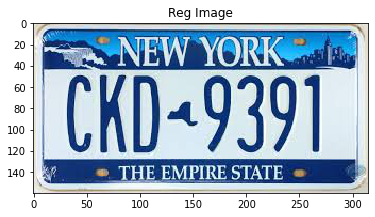

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


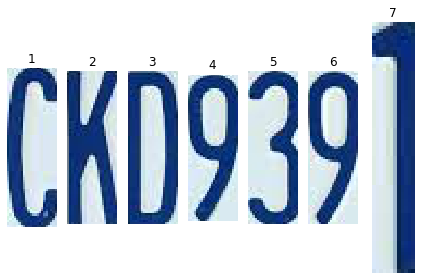

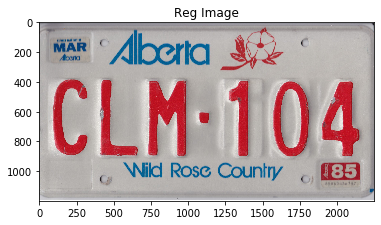

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


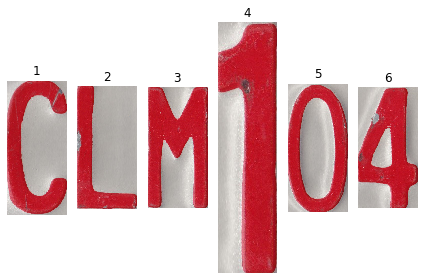

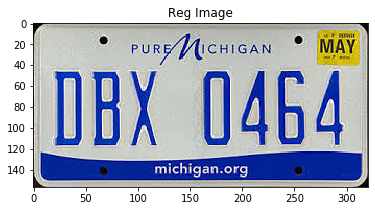

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


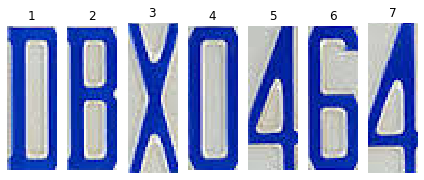

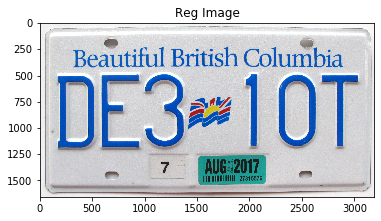

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


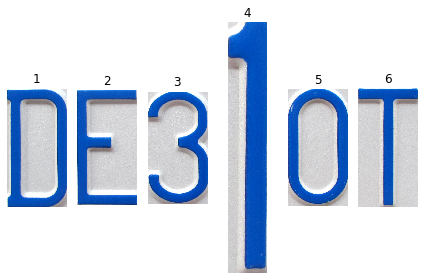

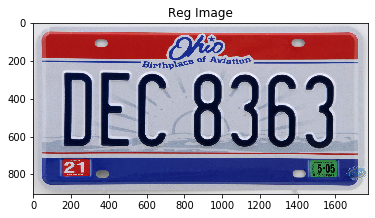

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


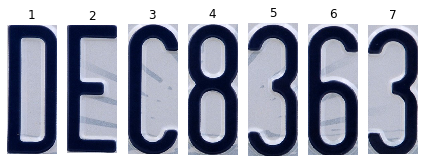

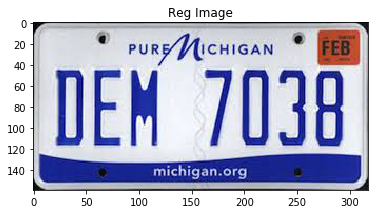

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


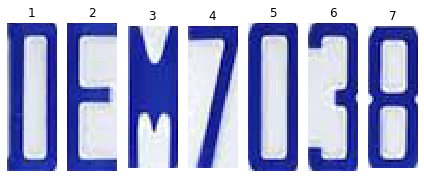

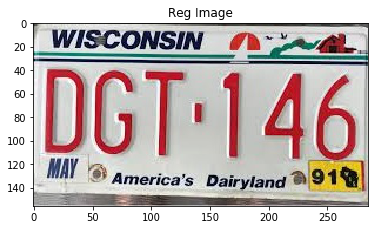

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


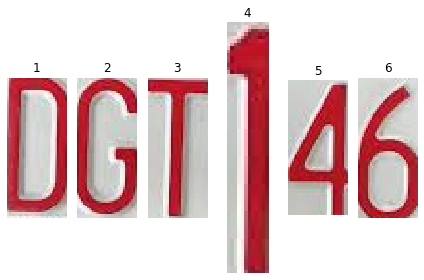

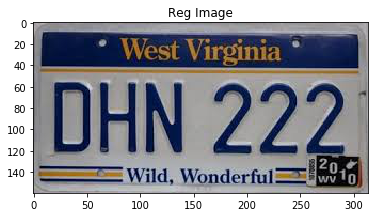

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


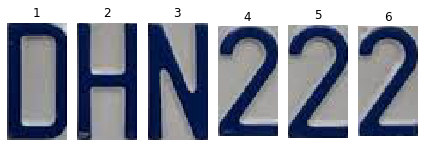

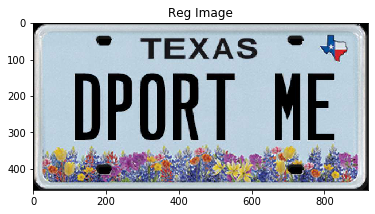

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


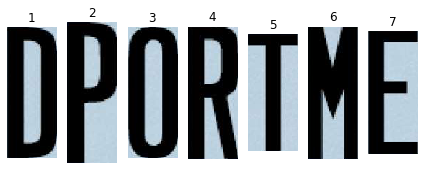

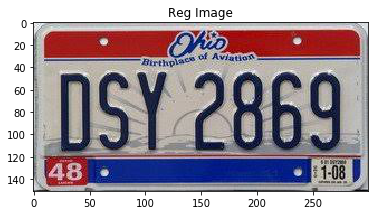

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


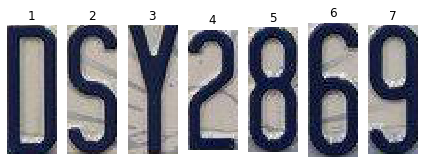

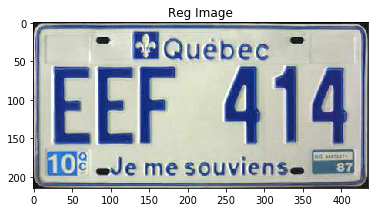

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


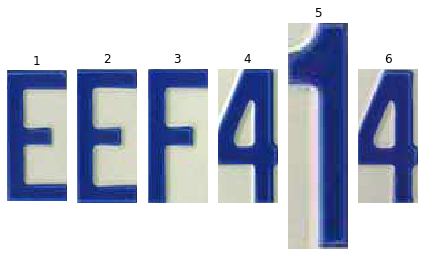

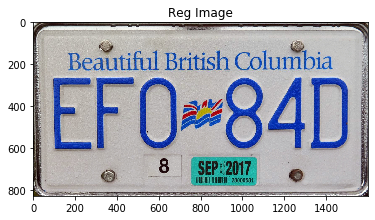

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


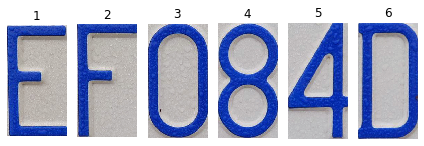

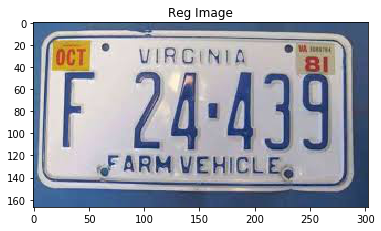

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


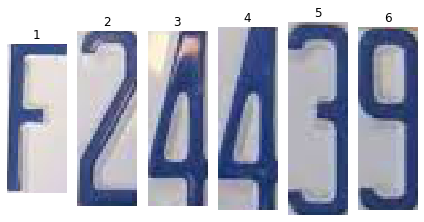

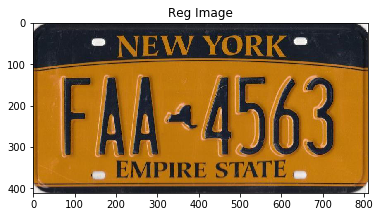

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


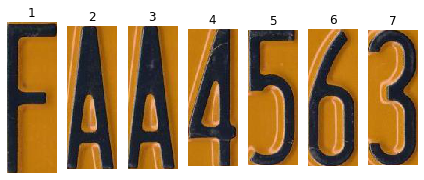

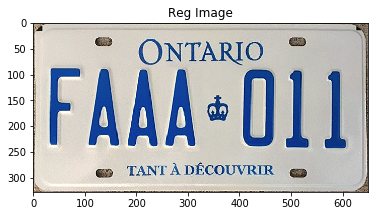

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


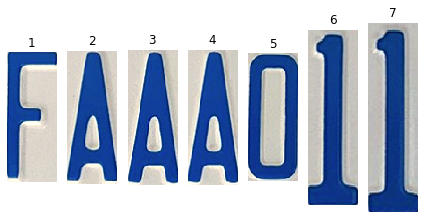

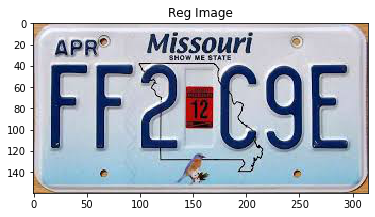

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


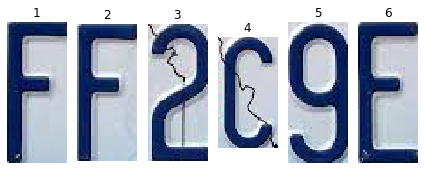

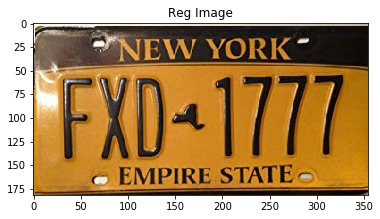

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


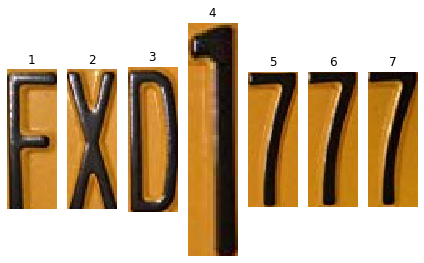

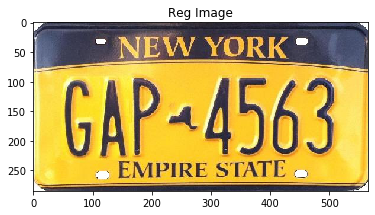

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


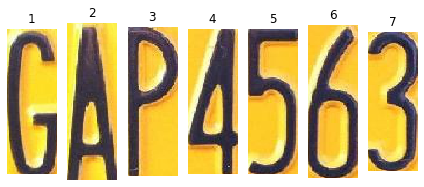

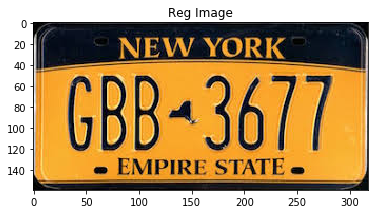

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


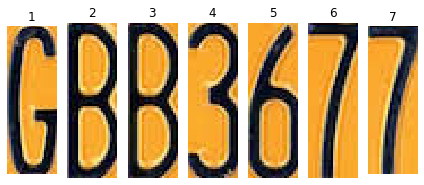

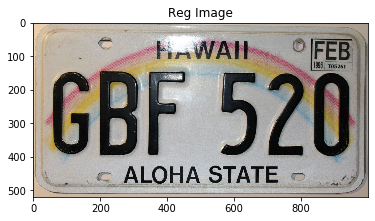

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


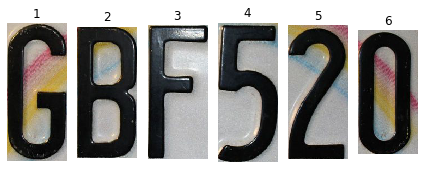

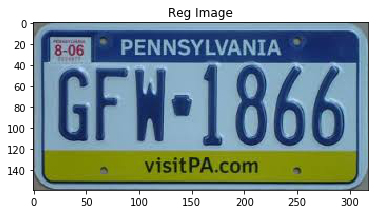

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


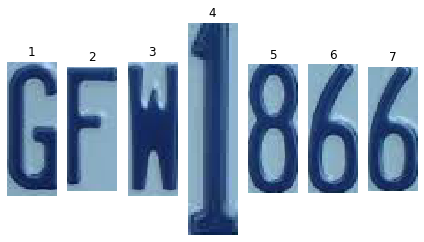

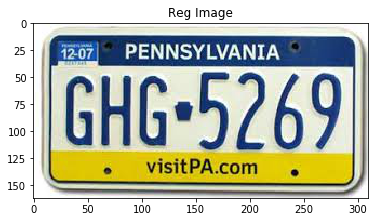

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


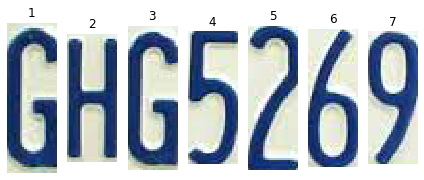

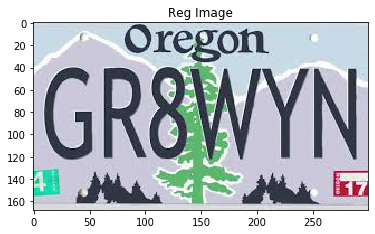

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


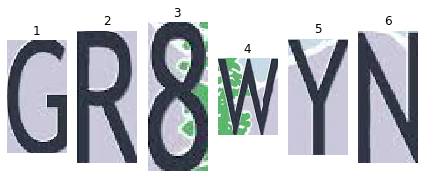

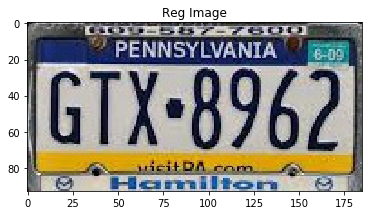

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


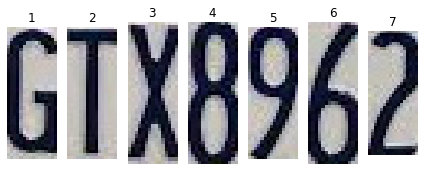

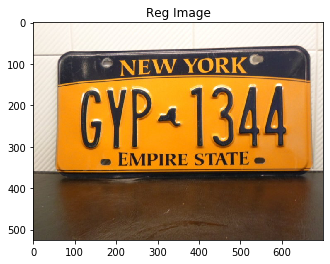

0


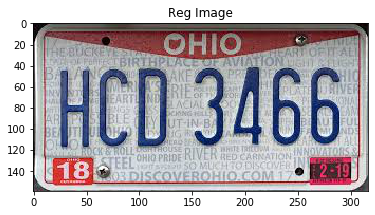

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


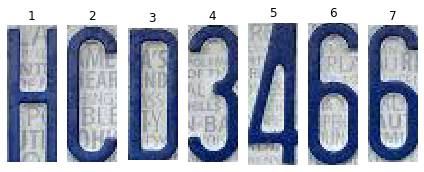

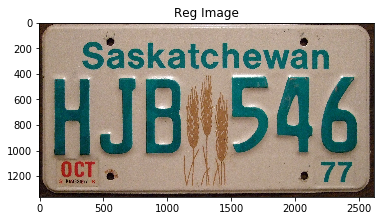

8


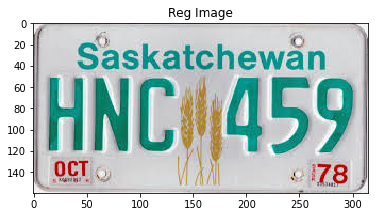

7


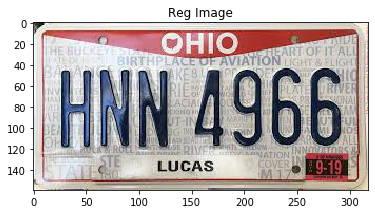

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


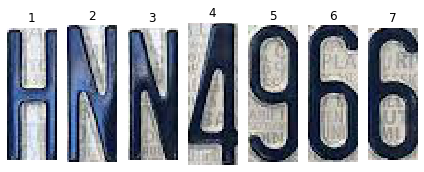

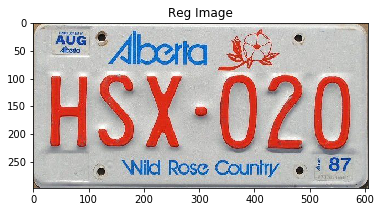

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


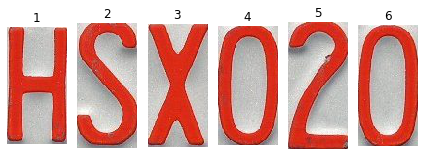

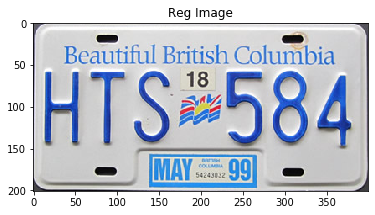

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


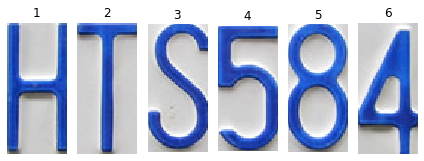

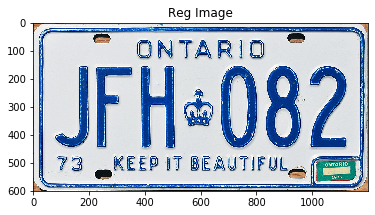

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


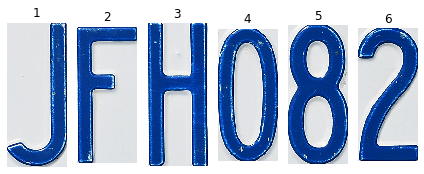

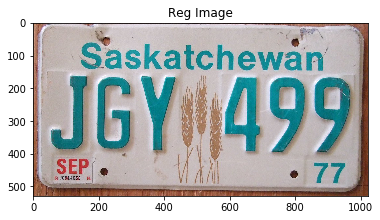

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


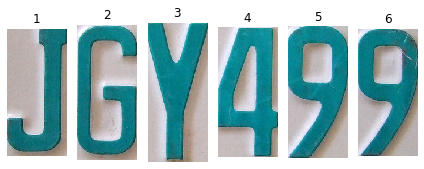

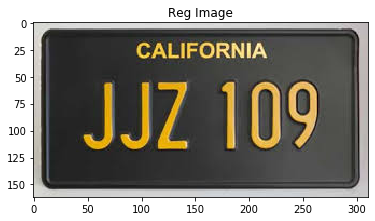

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


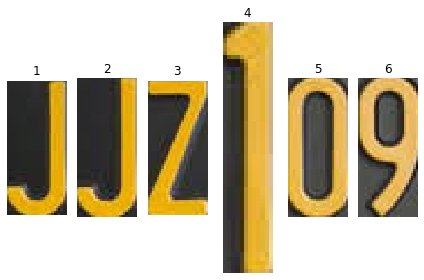

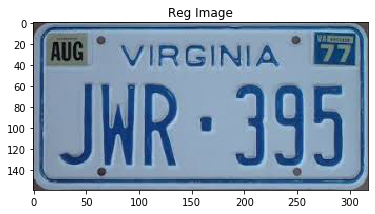

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


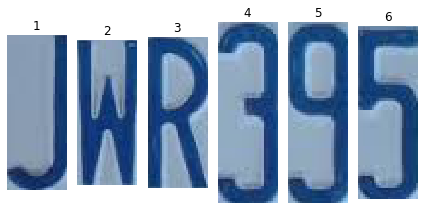

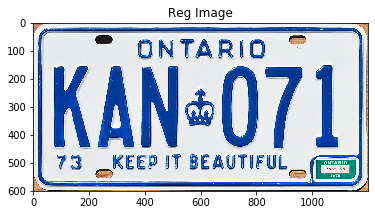

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


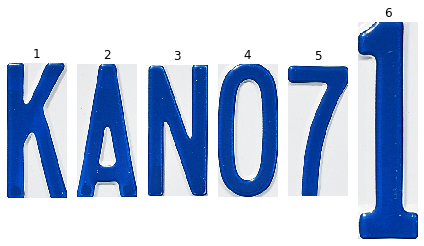

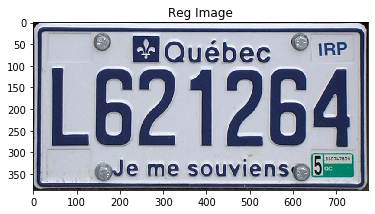

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


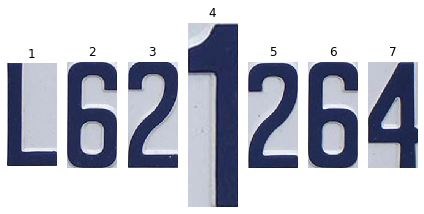

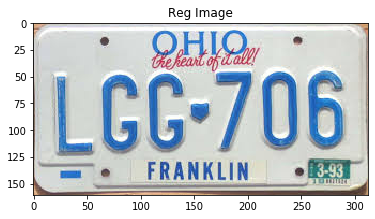

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


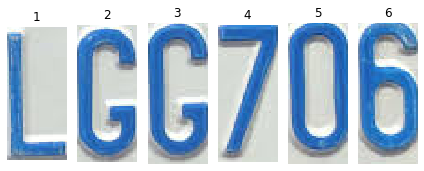

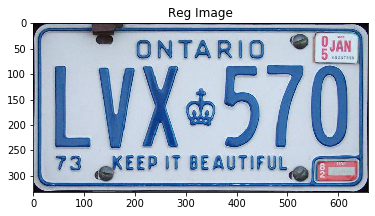

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


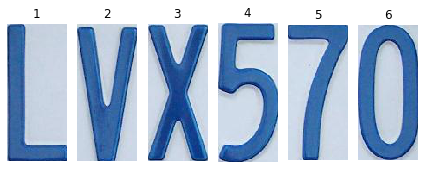

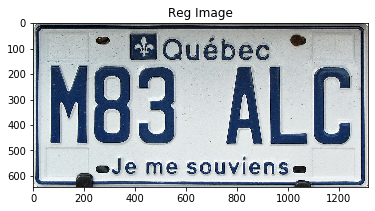

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


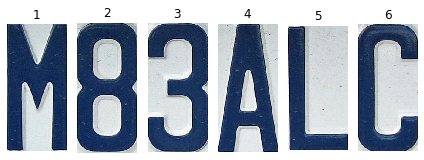

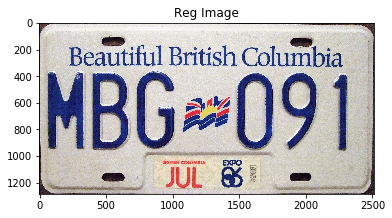

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


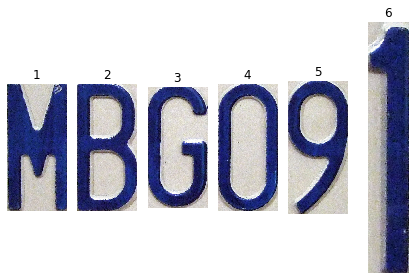

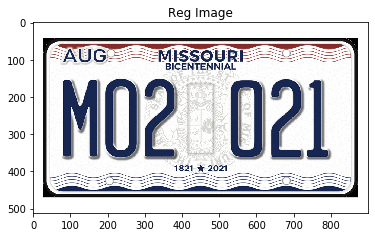

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


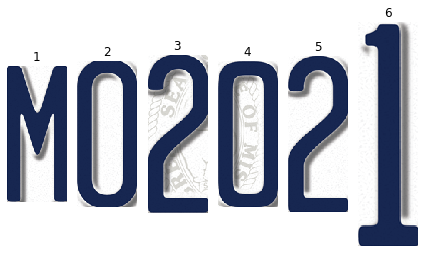

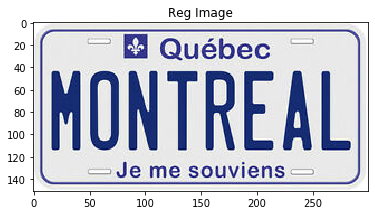

8
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


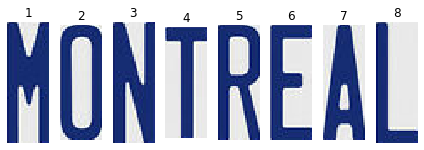

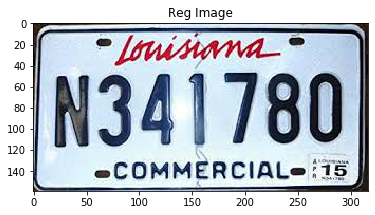

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


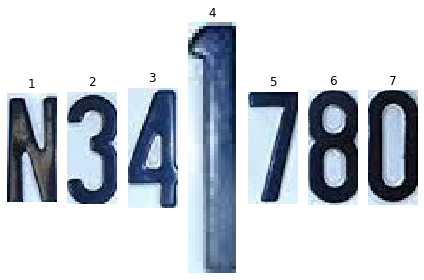

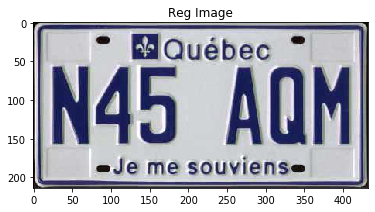

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


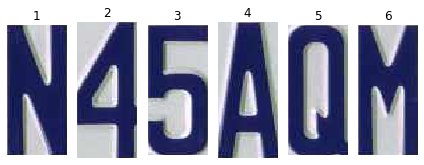

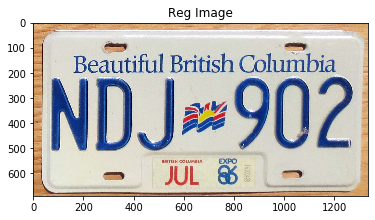

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


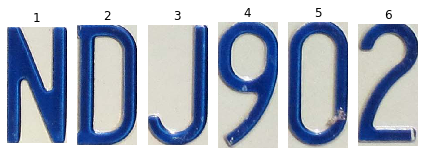

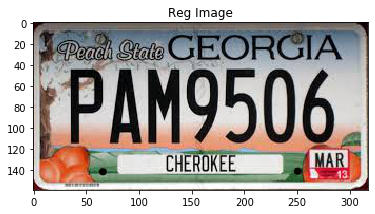

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


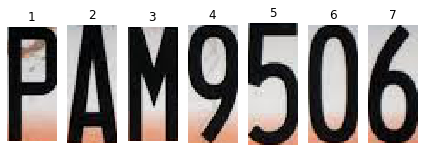

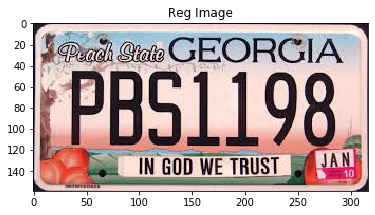

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


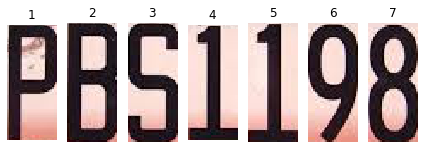

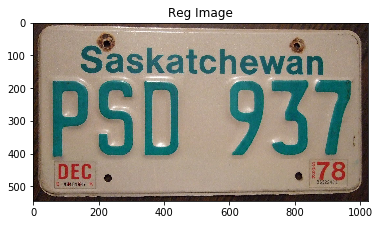

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


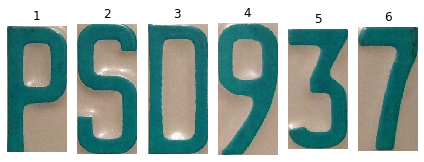

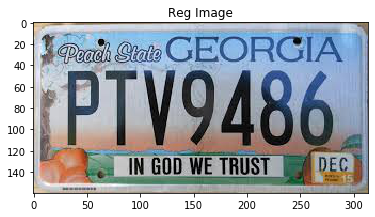

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


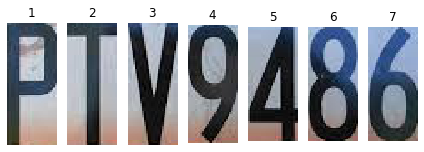

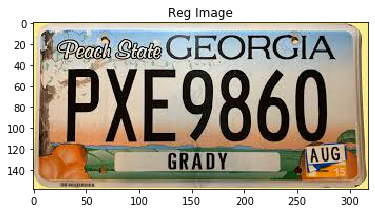

1


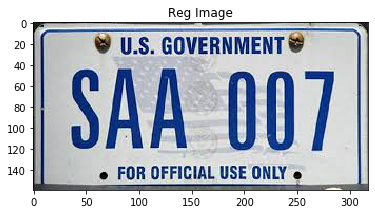

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


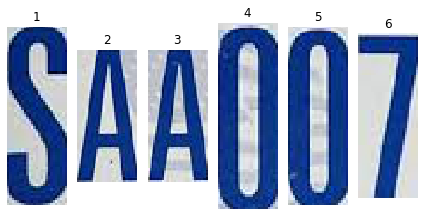

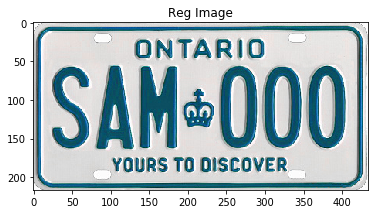

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


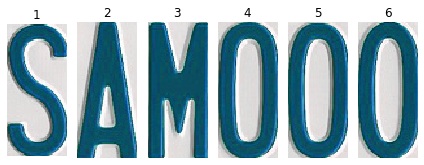

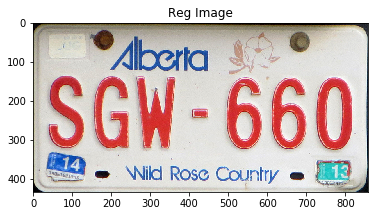

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


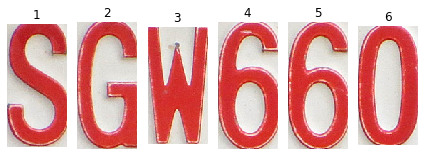

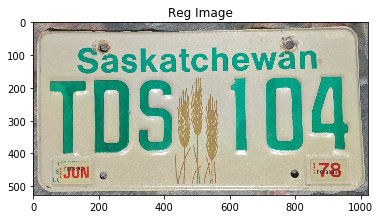

7


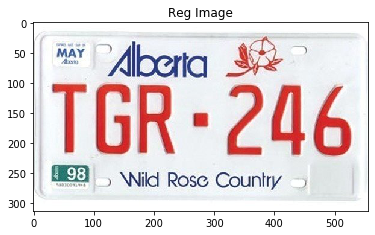

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


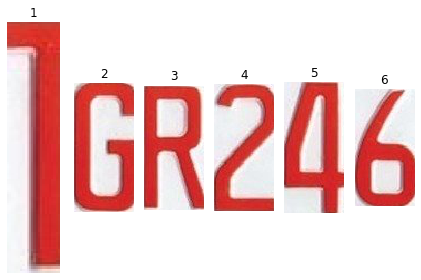

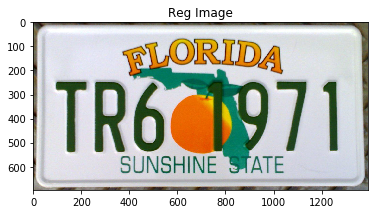

1


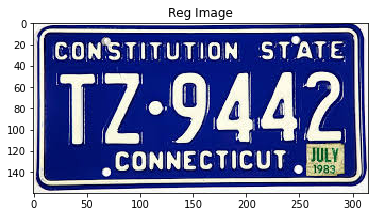

8


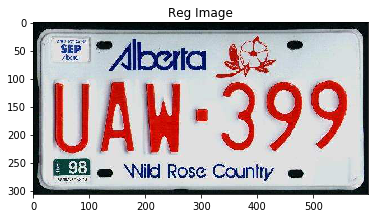

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


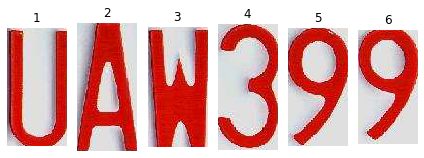

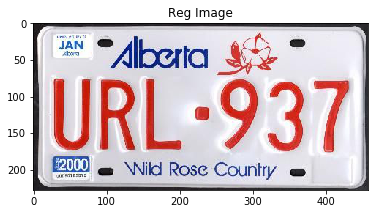

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


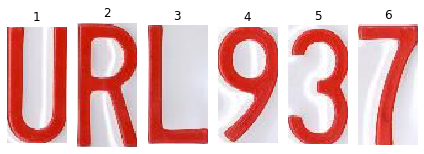

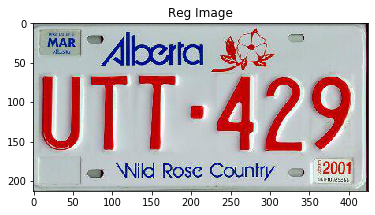

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


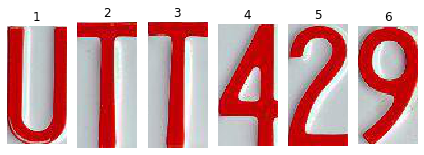

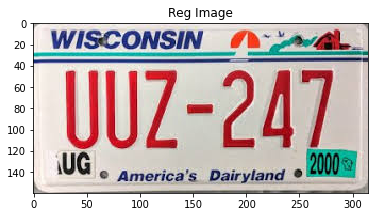

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


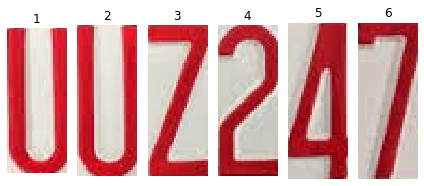

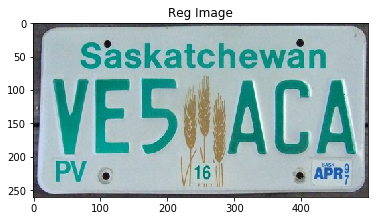

7


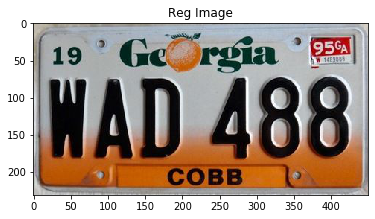

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


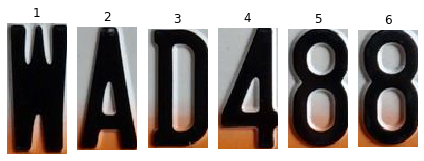

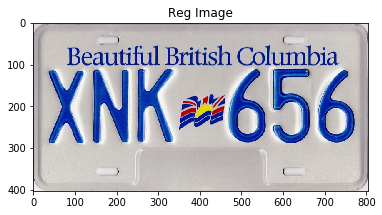

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


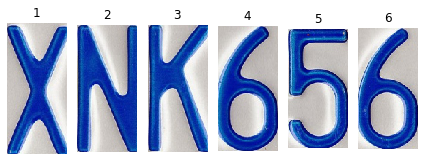

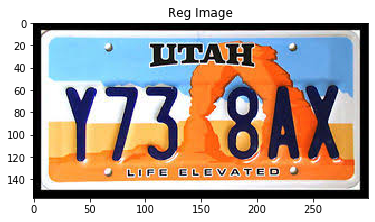

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


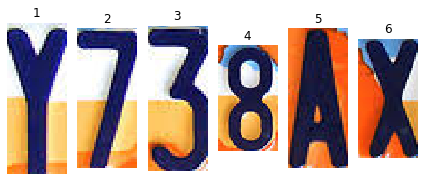

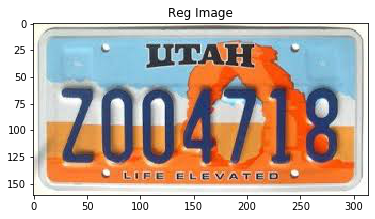

7
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


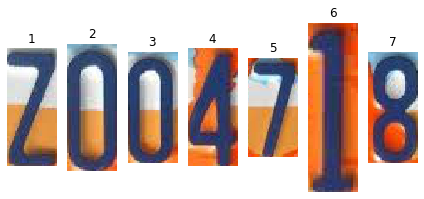

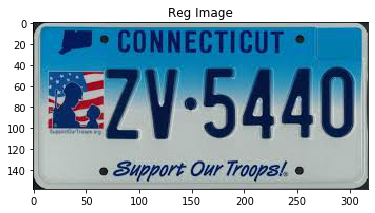

1


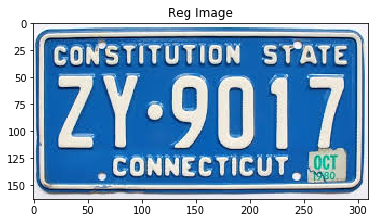

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


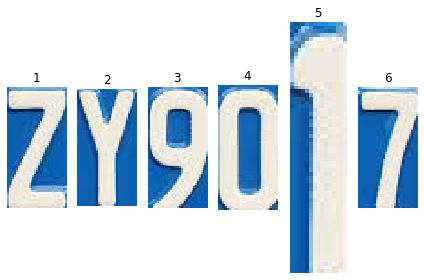

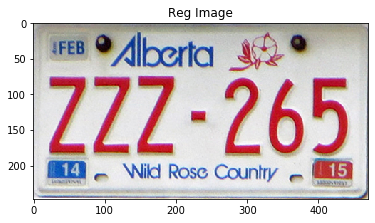

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


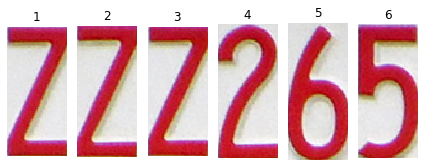

In [ ]:
#used to send pictures to google drive however currently this function

data_dir = '/content/drive/My Drive/APS360 Project/Final Submissions/'
path = F"/content/drive/My Drive/APS360 Project/Data/Individual_chars/" 
train_folder= 'Lisense Plate Images/'
all_images, all_labels, count, lisense_plate_num = segment_chars(data_dir, train_folder, path)

In [ ]:
#number of images used from original set

print("Number of lisense plates not in use: %d from set of %d" %(count,lisense_plate_num))

Number of lisense plates not in use: 17 from set of 192


In [ ]:
#make character labels (separated from lisense plate)
character_labels = []
i = 0
for label in all_labels:
  picture_index = label[-1]
  index_int = int(picture_index) 
  character_labels.append(label[index_int-1])
  print(character_labels[i] + ":" + label)
  i += 1

0:0000100_1
0:0000100_2
0:0000100_3
0:0000100_4
1:0000100_5
0:0000100_6
0:0000100_7
0:026MRW_1
2:026MRW_2
6:026MRW_3
M:026MRW_4
R:026MRW_5
W:026MRW_6
0:052SBD_1
5:052SBD_2
2:052SBD_3
S:052SBD_4
B:052SBD_5
D:052SBD_6
0:059NXC_1
5:059NXC_2
9:059NXC_3
N:059NXC_4
X:059NXC_5
C:059NXC_6
1:1430146_1
4:1430146_2
3:1430146_3
0:1430146_4
1:1430146_5
4:1430146_6
6:1430146_7
1:195SUQ_1
9:195SUQ_2
5:195SUQ_3
S:195SUQ_4
U:195SUQ_5
Q:195SUQ_6
2:2039BKX_1
0:2039BKX_2
3:2039BKX_3
9:2039BKX_4
B:2039BKX_5
K:2039BKX_6
X:2039BKX_7
2:215BG2_1
1:215BG2_2
5:215BG2_3
B:215BG2_4
G:215BG2_5
2:215BG2_6
2:241EKA_1
4:241EKA_2
1:241EKA_3
E:241EKA_4
K:241EKA_5
A:241EKA_6
2:246700_1
4:246700_2
6:246700_3
7:246700_4
0:246700_5
0:246700_6
2:247BZC_1
4:247BZC_2
7:247BZC_3
B:247BZC_4
Z:247BZC_5
C:247BZC_6
2:271LDZ_1
7:271LDZ_2
1:271LDZ_3
L:271LDZ_4
D:271LDZ_5
Z:271LDZ_6
2:29D177J_1
9:29D177J_2
D:29D177J_3
1:29D177J_4
7:29D177J_5
7:29D177J_6
J:29D177J_7
2:2CFJ70_1
C:2CFJ70_2
F:2CFJ70_3
J:2CFJ70_4
7:2CFJ70_5
0:2CFJ70_6
3:31

Lisense Plate Label: L621264_3
Character Label: 2


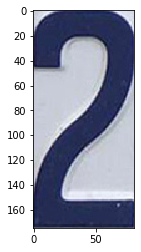

In [ ]:
import random
number = random.randrange(0,len(all_images)-1)
print("Lisense Plate Label: %s" %all_labels[number])
print("Character Label: %s" %character_labels[number])
plt.imshow(all_images[number])

In [ ]:
def character_to_digit(digit):
  conversion = {'0': 0,
                '1': 1,
                '2': 2,
                '3': 3,
                '4': 4,
                '5': 5,
                '6': 6,
                '7': 7,
                '8': 8,
                '9': 9,
                'A': 10,
                'B': 11,
                'C': 12,
                'D': 13,
                'E': 14,
                'F': 15,
                'G': 16,
                'H': 17,
                'I': 18,
                'J': 19,
                'K': 20,
                'L': 21,
                'M': 22,
                'N': 23,
                'O': 24,
                'P': 25,
                'Q': 26,
                'R': 27,
                'S': 28,
                'T': 29,
                'U': 30,
                'V': 31,
                'W': 32,
                'X': 33,
                'Y': 34,
                'Z': 35}

  return(int(conversion[digit]))


# Data Processing: Formatting Images

In [ ]:
#incoming images and labels
#all_images
#character_labels

In [ ]:
def make_square(im, fill_color="white"):
    x, y = im.size
    size = max(x, y)
    new_im = Image.new('RGB', (size, size), fill_color)
    new_im.paste(im, (int((size - x) / 2), int((size - y) / 2)))
    return new_im

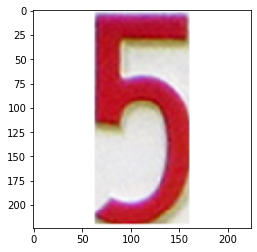

In [ ]:
from PIL import Image, ImageOps

data_transform = transforms.Compose([transforms.Resize(224), 
                                      transforms.ToTensor()])

images = []

for i in range(len(all_images)):

  current = all_images[i].copy()
  #current = test_data[i][0].copy()
  row, col = current.size

  if col > row:
    
    pad_width = round((col-row)/2)+1
    pad_height = 1
    padding = (pad_width, pad_height)
    new_im = ImageOps.expand(current, padding, fill= "white")
    new_im = make_square(new_im)
    img_final = data_transform(new_im)
    images.append(img_final) 
    plt.imshow(np.transpose(images[i], (1, 2, 0)))

  else:
    
    pad_width = 1
    pad_height = round((row-col)/2)+1
    padding = (pad_width, pad_height)
    new_im = ImageOps.expand(current, padding, fill= "white")
    new_im = make_square(new_im)
    img_final = data_transform(new_im)
    images.append(img_final) 
    plt.imshow(np.transpose(images[i], (1, 2, 0)))

Lisense Plate Label: 663MOH_2
Character Label: 6


torch.Size([3, 224, 224])

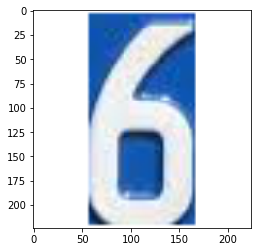

In [ ]:
import random
number = random.randrange(0,len(images)-1)
print("Lisense Plate Label: %s" %all_labels[number])
print("Character Label: %s" %character_labels[number])
plt.imshow(np.transpose(images[number], (1, 2, 0)))
images[number].shape

# Split into Train, Test, Validation

000010
760FZP
AxesImage(54,36;334.8x217.44)
tensor(21)
AxesImage(54,36;334.8x217.44)
tensor(13)
AxesImage(54,36;334.8x217.44)
tensor(6)
AxesImage(54,36;334.8x217.44)
tensor(12)
AxesImage(54,36;334.8x217.44)
tensor(4)
AxesImage(54,36;334.8x217.44)
tensor(6)
AxesImage(54,36;334.8x217.44)
tensor(11)
AxesImage(54,36;334.8x217.44)
tensor(1)
AxesImage(54,36;334.8x217.44)
tensor(25)
AxesImage(54,36;334.8x217.44)
tensor(35)
AxesImage(54,36;334.8x217.44)
tensor(2)
AxesImage(54,36;334.8x217.44)
tensor(1)
AxesImage(54,36;334.8x217.44)
tensor(9)
AxesImage(54,36;334.8x217.44)
tensor(1)
AxesImage(54,36;334.8x217.44)
tensor(2)
AxesImage(54,36;334.8x217.44)
tensor(13)
AxesImage(54,36;334.8x217.44)
tensor(0)
AxesImage(54,36;334.8x217.44)
tensor(13)
AxesImage(54,36;334.8x217.44)
tensor(4)
AxesImage(54,36;334.8x217.44)
tensor(32)
AxesImage(54,36;334.8x217.44)
tensor(7)
AxesImage(54,36;334.8x217.44)
tensor(16)
AxesImage(54,36;334.8x217.44)
tensor(1)
AxesImage(54,36;334.8x217.44)
tensor(23)
AxesImage(54,36

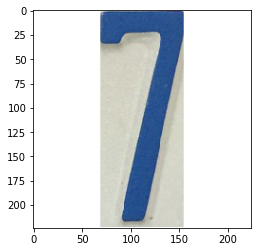

In [ ]:
import random

#use approx 60% to train, 20% to validate, 20% to test
#basically need to keep liscense plate characters together

#make a list of dictionaries: each dictionary key will be the full liscense plate -> each dictionary will have a list of images and labels ->list element is image and label
#shuffle list

data_pre_shuffle = {}

for i in range(0, len(all_labels)):
  #list_entry = {}
  if all_labels[i][:6] not in data_pre_shuffle:
    data_pre_shuffle[all_labels[i][:6]] = []
  list_entry = {'data': images[i], 
                'character_label': character_labels[i],
                'all_label': all_labels[i]}
  data_pre_shuffle[all_labels[i][:6]].append(list_entry)

data_to_shuffle = []

for key, entry in data_pre_shuffle.items():
  #print(key)
  #print(entry)
  data_to_shuffle.append({'key': key, 'entry': entry})

#integer division
size_train = len(data_to_shuffle)*6/10
size_val = len(data_to_shuffle)*2/10
size_test = len(data_to_shuffle) - size_train - size_val
#then split list into 3 sets

print(data_to_shuffle[0]['key'])
random.shuffle(data_to_shuffle)
random.shuffle(data_to_shuffle)
random.shuffle(data_to_shuffle)
print(data_to_shuffle[0]['key'])
#retrieve data and put it into dataloader

train_set = []
val_set = []
test_set = []

for i in range(0, len(data_to_shuffle)):

  #unpack data
  if i < size_train:
    for entry in data_to_shuffle[i]['entry']:
      #make tuple (image, label) pair for dataloader
      train_set.append((entry['data'],character_to_digit(entry['character_label'])))
  elif i < size_train + size_val:
    for entry in data_to_shuffle[i]['entry']:
      #make tuple (image, label) pair for dataloader
      val_set.append((entry['data'],character_to_digit(entry['character_label'])))   
  else:
    for entry in data_to_shuffle[i]['entry']:
      #make tuple (image, label) pair for dataloader
      test_set.append((entry['data'],character_to_digit(entry['character_label'])))

# define dataloader parameters
batch_size  = 20
num_workers = 0

# prepare data loaders
train_loader = torch.utils.data.DataLoader(train_set, batch_size=batch_size, 
                                           num_workers=num_workers, shuffle=True)

# prepare data loaders
valid_loader = torch.utils.data.DataLoader(val_set, batch_size=batch_size, 
                                           num_workers=num_workers, shuffle=True)
# prepare data loaders
test_loader = torch.utils.data.DataLoader(test_set, batch_size=batch_size, 
                                           num_workers=num_workers, shuffle=True)

#all good
for imgs, labels in train_loader:
  print(plt.imshow(np.transpose(imgs[0], (1, 2, 0))))
  print(labels[0])

In [ ]:
type(valid_loader)

torch.utils.data.dataloader.DataLoader

In [ ]:
#Ensures that train data has all letters
all_train_digits = []

for i in range(len(train_set)):
   if train_set[i][1] not in all_train_digits:
    all_train_digits.append(train_set[i][1])

In [ ]:
len(all_train_digits)

36

# Model 

In [ ]:
import torchvision.models
alexnet = torchvision.models.alexnet(pretrained=True)

def get_features(dataset):
  features = []
  for i, data in enumerate(dataset, 0):
      inputs, labels = data
      #print(inputs.shape)
      #print(labels.shape)
      f = alexnet.features(inputs)
      f = torch.from_numpy(f.detach().numpy())
      features.append((f, labels))
  return features

In [ ]:
class charClassifier(nn.Module):
    def __init__(self):
        super(charClassifier, self).__init__()
        self.fc1 = nn.Linear(256 * 6 * 6, 500)
        self.fc2 = nn.Linear(500, 36)

    def forward(self, x):
        x = x.view(-1, 256 * 6 * 6) #flatten feature data
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

In [ ]:
def evaluate(model, data):
    correct = 0
    total = 0
    
    model.eval() #*********#
    
    #############################################
    #To Enable GPU Usage
    if torch.cuda.is_available():
      model.cuda()
    #############################################

    for imgs, labels in data:
        #############################################
        #To Enable GPU Usage
        if torch.cuda.is_available():
          imgs = imgs.cuda()
          labels = labels.cuda()
        #############################################
        output = model(imgs)
        pred = output.max(1, keepdim=True)[1] # get the index of the max logit
        correct += pred.eq(labels.view_as(pred)).sum().item()
        total += imgs.shape[0]
        acc = correct/total
    return acc

In [ ]:
def train_with_features(model, train_f, val_f, batch_size=500, num_epochs=100):

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.9)

    iters, losses, train_acc, val_acc = [], [], [], []

    # training
    n = 0 # the number of iterations
    for epoch in range(num_epochs):
        # print(epoch)
        for features, labels in train_f:

            #############################################
            #To Enable GPU Usage
            if torch.cuda.is_available():
              features = features.cuda()
              labels = labels.cuda()
            
            ############################################# 
            model.train()
            out = model(features)             # forward pass
            #print(out.size)
            #print(labels)
            #print(out)
            #print(labels.size)
            loss = criterion(out, labels) # compute the total loss
            loss.backward()               # backward pass (compute parameter updates)
            optimizer.step()              # make the updates for each parameter
            optimizer.zero_grad()         # a clean up step for PyTorch

            # save the current training information
            iters.append(n)
            losses.append(float(loss)/batch_size)             # compute *average* loss
            train_acc.append(evaluate(model, train_f)) # compute training accuracy 
            val_acc.append(evaluate(model, val_f)) # compute training accuracy 
            n += 1
        

    # plotting
    plt.title("Training Curve")
    plt.plot(iters, losses, label="Train")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.show()

    plt.title("Training Curve")
    plt.plot(iters, train_acc, label="Train")
    plt.plot(iters, val_acc, label="Validation")
    plt.xlabel("Iterations")
    plt.ylabel("Training Accuracy")
    plt.legend(loc='best')
    plt.show()

    print("Final Training Accuracy: {}".format(train_acc[-1]))
    print("Final Validation Accuracy: {}".format(val_acc[-1]))

    

In [ ]:
train_features = get_features(train_loader)
valid_features = get_features(valid_loader)

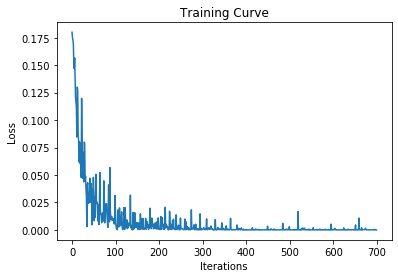

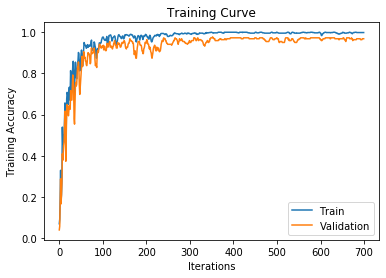

Final Training Accuracy: 0.998533724340176
Final Validation Accuracy: 0.9684684684684685


In [ ]:
charANN = charClassifier()

#############################################
#To Enable GPU Usage
if torch.cuda.is_available():
  charANN.cuda()
#############################################

train_with_features(charANN, train_features, valid_features, batch_size=20, num_epochs=20)

# Prediction Model

In [ ]:
test_features = get_features(test_loader)

In [ ]:
digit = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']

In [ ]:
def prediction(model, data):

    correct = 0
    total = 0
    
    model.eval() #*********#
    
    #############################################
    #To Enable GPU Usage
    if torch.cuda.is_available():
      model.cuda()
    #############################################
    num = 0

    for imgs, labels in data:
        #############################################
        #To Enable GPU Usage
        if torch.cuda.is_available():
          imgs = imgs.cuda()
          labels = labels.cuda()
        #############################################
        output = model(imgs)
        pred = output.max(1, keepdim=True)[1] # get the index of the max logit
        #print(character_to_digit.item(pred))
        #print(type(pred))
        #print(pred)

        for i in range(len(pred)):
          print("Predicted: " + digit[pred[i]] + " Actual: " + digit[labels[i]])
          #if digit[labels[i]] == '2':
          #  print("yes")
          
        correct += pred.eq(labels.view_as(pred)).sum().item()
        total += imgs.shape[0]
        acc = correct/total
    return acc

In [ ]:
evaluate(charANN, test_features)

0.9539170506912442

In [ ]:
prediction(charANN, test_features)

Predicted: V Actual: V
Predicted: 4 Actual: 4
Predicted: 1 Actual: 1
Predicted: F Actual: F
Predicted: 1 Actual: 1
Predicted: 5 Actual: 5
Predicted: 8 Actual: 8
Predicted: 7 Actual: 7
Predicted: J Actual: J
Predicted: 7 Actual: 7
Predicted: Z Actual: Z
Predicted: A Actual: A
Predicted: 8 Actual: 8
Predicted: G Actual: G
Predicted: 3 Actual: 3
Predicted: U Actual: U
Predicted: 6 Actual: 6
Predicted: 2 Actual: 2
Predicted: 0 Actual: 0
Predicted: N Actual: N
Predicted: M Actual: M
Predicted: 9 Actual: 9
Predicted: 5 Actual: 5
Predicted: 4 Actual: 4
Predicted: 4 Actual: 4
Predicted: A Actual: A
Predicted: 1 Actual: I
Predicted: 3 Actual: 3
Predicted: 4 Actual: 4
Predicted: 3 Actual: 3
Predicted: 0 Actual: 0
Predicted: V Actual: V
Predicted: 9 Actual: 9
Predicted: L Actual: L
Predicted: H Actual: H
Predicted: 0 Actual: 0
Predicted: F Actual: F
Predicted: 0 Actual: 0
Predicted: 5 Actual: 5
Predicted: A Actual: A
Predicted: R Actual: R
Predicted: 7 Actual: 7
Predicted: 1 Actual: 1
Predicted: 

0.9539170506912442

In [ ]:
# for i in range(len(test_set)):
#   if test_set[i][1] == 2:
#     print("yes")

# DEMO Section

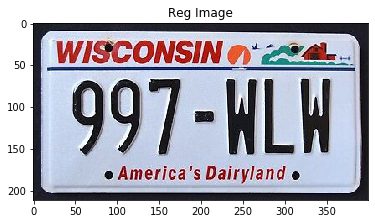

6
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory
Images not saved in directory


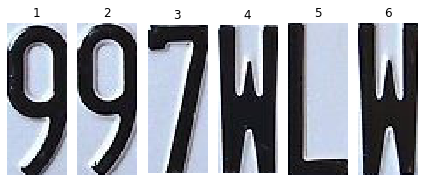

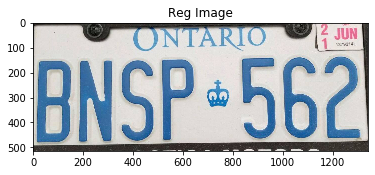

0


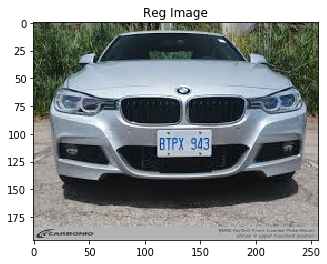

0
Lisense Plate Label: 997WLW_4
Character Label: W


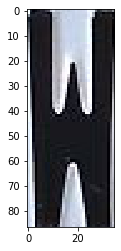

In [ ]:
data_dir = "/content/drive/My Drive/APS360 Project/Final Submissions/Demo Lisense Plate Images/"
dataset = ImageFolderWithFileName(data_dir) # our custom dataset

data_dir = '/content/drive/My Drive/APS360 Project/Final Submissions/'
path = F"/content/drive/My Drive/APS360 Project/Data/Individual_chars/" 
demo_folder= 'Demo Lisense Plate Images/'
all_images, all_labels, count, lisense_plate_num = segment_chars(data_dir, demo_folder, path)


#make character labels (separated from lisense plate)
character_labels = []
i = 0
for label in all_labels:
  picture_index = label[-1]
  index_int = int(picture_index) 
  character_labels.append(label[index_int-1])
  i += 1

number = random.randrange(0,len(all_images)-1)
print("Lisense Plate Label: %s" %all_labels[number])
print("Character Label: %s" %character_labels[number])
plt.imshow(all_images[number])


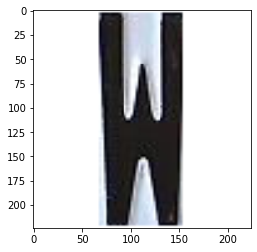

In [ ]:
data_transform = transforms.Compose([transforms.Resize(224), 
                                      transforms.ToTensor()])

images = []

for i in range(len(all_images)):

  current = all_images[i].copy()
  #current = test_data[i][0].copy()
  row, col = current.size

  if col > row:
    
    pad_width = round((col-row)/2)+1
    pad_height = 1
    padding = (pad_width, pad_height)
    new_im = ImageOps.expand(current, padding, fill= "white")
    new_im = make_square(new_im)
    img_final = data_transform(new_im)
    images.append(img_final) 
    plt.imshow(np.transpose(images[i], (1, 2, 0)))

  else:
    
    pad_width = 1
    pad_height = round((row-col)/2)+1
    padding = (pad_width, pad_height)
    new_im = ImageOps.expand(current, padding, fill= "white")
    new_im = make_square(new_im)
    img_final = data_transform(new_im)
    images.append(img_final) 
    plt.imshow(np.transpose(images[i], (1, 2, 0)))

In [ ]:
demo_set = []

for i in range(0, len(character_labels)):
  demo_set.append((images[i], character_to_digit(character_labels[i])))

# prepare data loaders
demo_loader = torch.utils.data.DataLoader(demo_set, batch_size=batch_size, 
                                           num_workers=num_workers)

demo_features = get_features(demo_loader)
prediction(charANN, demo_features)

Predicted: 9 Actual: 9
Predicted: 9 Actual: 9
Predicted: 7 Actual: 7
Predicted: W Actual: W
Predicted: L Actual: L
Predicted: W Actual: W


1.0

# Baseline Model (Not the Actual Liscense Plate Recognition System)

In [ ]:
data = []
data_dir = '/content/drive/My Drive/APS360 Project/Final Submissions/Lisense Plate Images/Images'
for filename in os.listdir(data_dir):
    if filename.endswith("jpg"): 
      if "_" not in filename:
          plate = filename.split(".")[0]
          data.append(plate)
print(len(data))

183


In [ ]:
max_len = max([len(i) for i in data])
min_len = min([len(i) for i in data])

data_breakdown = {}
final_prediction = []

for plate in data:
  position = 0
  for char in plate:
    if position not in data_breakdown:
      data_breakdown[position] = {}
    if char not in data_breakdown[position]:
      data_breakdown[position][char] = 1
    else:
      data_breakdown[position][char] += 1
    position += 1

print("data breakdown: ",data_breakdown)



for _, secondary_list in data_breakdown.items():
  char = max(secondary_list.items(), key=operator.itemgetter(1))[0]
  times_appeared = max(secondary_list.items(), key=operator.itemgetter(1))[1]
  print(char,times_appeared)
  final_prediction.append(char)

print("Most common: ",final_prediction)

data breakdown:  {0: {'T': 4, 'U': 4, 'Y': 1, 'Z': 4, 'X': 1, 'B': 20, '6': 11, '2': 9, '1': 3, '5': 8, '3': 9, '7': 7, '0': 4, '9': 7, 'D': 8, '4': 7, 'M': 3, '8': 5, 'A': 15, 'C': 12, 'E': 2, 'G': 8, 'F': 5, 'N': 3, 'J': 4, 'K': 1, 'H': 5, 'L': 3, 'S': 3, 'P': 5, 'W': 1, 'V': 1}, 1: {'G': 9, 'A': 15, 'R': 4, '7': 6, '0': 4, 'T': 6, 'N': 4, 'U': 1, 'Z': 2, 'M': 2, 'P': 4, 'C': 6, 'S': 6, 'L': 2, '9': 7, '2': 11, 'E': 8, '1': 5, '4': 10, '5': 10, 'B': 11, '3': 4, '6': 6, 'J': 5, 'Q': 1, 'Y': 3, 'D': 4, 'F': 7, 'K': 4, 'V': 3, 'W': 2, 'X': 4, 'H': 4, 'O': 1, '8': 2}, 2: {'R': 5, 'W': 3, '6': 8, '3': 15, '0': 7, 'T': 2, 'L': 5, 'K': 3, 'Z': 3, 'F': 5, 'P': 4, '2': 6, 'I': 2, 'A': 7, '4': 8, 'D': 7, 'G': 4, 'N': 7, 'B': 3, '9': 10, '1': 3, '5': 11, '7': 8, '8': 5, 'M': 6, 'C': 5, 'H': 5, 'J': 3, 'Q': 2, 'V': 5, 'E': 2, 'X': 7, 'S': 4, 'O': 1, 'Y': 2}, 3: {'2': 8, '3': 7, '1': 19, '8': 7, '4': 12, '9': 11, '6': 4, 'J': 8, 'E': 7, '0': 12, 'K': 4, 'M': 3, 'G': 3, '7': 15, 'D': 3, 'N': 3, 'S

In [ ]:
totalChar, correctChar = 0, 0
for plate in data:
  for index in range(len(plate)):
    if final_prediction[index] == plate[index]:
      correctChar +=1
    totalChar += 1
print(correctChar/totalChar*100,"%")

10.178117048346055 %
